# Afriat

In [1]:
scan=0.1225

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2546,3294,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2546,2574,1706,3411,1618,3388
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4454,10789
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 659,815,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 659,628,402,879,431,811
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1130,2680
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:24:34, 14.48s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:24:34, 14.48s/it, v_num=1, total_loss_train=3.74e+3, kl_local_train=54.4]

Epoch 2/600:   0%|          | 1/600 [00:14<2:24:34, 14.48s/it, v_num=1, total_loss_train=3.74e+3, kl_local_train=54.4]

Epoch 2/600:   0%|          | 2/600 [00:27<2:17:41, 13.81s/it, v_num=1, total_loss_train=3.74e+3, kl_local_train=54.4]

Epoch 2/600:   0%|          | 2/600 [00:27<2:17:41, 13.81s/it, v_num=1, total_loss_train=3.24e+3, kl_local_train=80]  

Epoch 3/600:   0%|          | 2/600 [00:27<2:17:41, 13.81s/it, v_num=1, total_loss_train=3.24e+3, kl_local_train=80]

Epoch 3/600:   0%|          | 3/600 [00:41<2:16:02, 13.67s/it, v_num=1, total_loss_train=3.24e+3, kl_local_train=80]

Epoch 3/600:   0%|          | 3/600 [00:41<2:16:02, 13.67s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=81.8]

Epoch 4/600:   0%|          | 3/600 [00:41<2:16:02, 13.67s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=81.8]

Epoch 4/600:   1%|          | 4/600 [00:54<2:15:10, 13.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=81.8]

Epoch 4/600:   1%|          | 4/600 [00:54<2:15:10, 13.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=79.3]

Epoch 5/600:   1%|          | 4/600 [00:54<2:15:10, 13.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=79.3]

Epoch 5/600:   1%|          | 5/600 [01:08<2:15:44, 13.69s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=79.3]

Epoch 5/600:   1%|          | 5/600 [01:08<2:15:44, 13.69s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=74]  

Epoch 6/600:   1%|          | 5/600 [01:10<2:15:44, 13.69s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=74]

Epoch 6/600:   1%|          | 6/600 [01:22<2:17:39, 13.90s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=74]

Epoch 6/600:   1%|          | 6/600 [01:23<2:17:39, 13.90s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 6/600 [01:23<2:17:39, 13.90s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:36<2:15:34, 13.72s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:36<2:15:34, 13.72s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|          | 7/600 [01:36<2:15:34, 13.72s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:49<2:13:40, 13.55s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:49<2:13:40, 13.55s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=33.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 9/600:   1%|▏         | 8/600 [01:49<2:13:40, 13.55s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=33.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [02:03<2:13:19, 13.54s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=33.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [02:03<2:13:19, 13.54s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 9/600 [02:03<2:13:19, 13.54s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:16<2:12:49, 13.51s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:16<2:12:49, 13.51s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=27.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351] 

Epoch 11/600:   2%|▏         | 10/600 [02:17<2:12:49, 13.51s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=27.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:30<2:15:03, 13.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=27.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00748, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:30<2:15:03, 13.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=35.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439] 

Epoch 12/600:   2%|▏         | 11/600 [02:30<2:15:03, 13.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=35.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 12/600:   2%|▏         | 12/600 [02:43<2:12:09, 13.49s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=35.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 12/600:   2%|▏         | 12/600 [02:43<2:12:09, 13.49s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 13/600:   2%|▏         | 12/600 [02:43<2:12:09, 13.49s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 13/600:   2%|▏         | 13/600 [02:56<2:09:40, 13.25s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 13/600:   2%|▏         | 13/600 [02:56<2:09:40, 13.25s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 14/600:   2%|▏         | 13/600 [02:56<2:09:40, 13.25s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 14/600:   2%|▏         | 14/600 [03:08<2:06:44, 12.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 14/600:   2%|▏         | 14/600 [03:08<2:06:44, 12.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 15/600:   2%|▏         | 14/600 [03:08<2:06:44, 12.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 15/600:   2%|▎         | 15/600 [03:21<2:05:54, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 15/600:   2%|▎         | 15/600 [03:21<2:05:54, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 16/600:   2%|▎         | 15/600 [03:22<2:05:54, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 16/600:   3%|▎         | 16/600 [03:35<2:08:50, 13.24s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0181, metric_mi|mouse_train=0.0439]

Epoch 16/600:   3%|▎         | 16/600 [03:35<2:08:50, 13.24s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 17/600:   3%|▎         | 16/600 [03:35<2:08:50, 13.24s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 17/600:   3%|▎         | 17/600 [03:48<2:06:53, 13.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 17/600:   3%|▎         | 17/600 [03:48<2:06:53, 13.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=62.9, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 18/600:   3%|▎         | 17/600 [03:48<2:06:53, 13.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=62.9, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 18/600:   3%|▎         | 18/600 [04:00<2:05:07, 12.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=62.9, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 18/600:   3%|▎         | 18/600 [04:00<2:05:07, 12.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=65.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 19/600:   3%|▎         | 18/600 [04:00<2:05:07, 12.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=65.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 19/600:   3%|▎         | 19/600 [04:13<2:03:38, 12.77s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=65.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 19/600:   3%|▎         | 19/600 [04:13<2:03:38, 12.77s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 20/600:   3%|▎         | 19/600 [04:13<2:03:38, 12.77s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 20/600:   3%|▎         | 20/600 [04:25<2:02:53, 12.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 20/600:   3%|▎         | 20/600 [04:25<2:02:53, 12.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76.3, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 21/600:   3%|▎         | 20/600 [04:27<2:02:53, 12.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76.3, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 21/600:   4%|▎         | 21/600 [04:39<2:06:03, 13.06s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76.3, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0637]

Epoch 21/600:   4%|▎         | 21/600 [04:39<2:06:03, 13.06s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]  

Epoch 22/600:   4%|▎         | 21/600 [04:39<2:06:03, 13.06s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 22/600:   4%|▎         | 22/600 [04:51<2:03:55, 12.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 22/600:   4%|▎         | 22/600 [04:51<2:03:55, 12.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 23/600:   4%|▎         | 22/600 [04:51<2:03:55, 12.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 23/600:   4%|▍         | 23/600 [05:03<2:00:09, 12.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 23/600:   4%|▍         | 23/600 [05:03<2:00:09, 12.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 24/600:   4%|▍         | 23/600 [05:03<2:00:09, 12.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 24/600:   4%|▍         | 24/600 [05:14<1:56:40, 12.15s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 24/600:   4%|▍         | 24/600 [05:14<1:56:40, 12.15s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 25/600:   4%|▍         | 24/600 [05:14<1:56:40, 12.15s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 25/600:   4%|▍         | 25/600 [05:26<1:54:46, 11.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 25/600:   4%|▍         | 25/600 [05:26<1:54:46, 11.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804] 

Epoch 26/600:   4%|▍         | 25/600 [05:27<1:54:46, 11.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 26/600:   4%|▍         | 26/600 [05:39<1:56:55, 12.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0804]

Epoch 26/600:   4%|▍         | 26/600 [05:39<1:56:55, 12.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926] 

Epoch 27/600:   4%|▍         | 26/600 [05:39<1:56:55, 12.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 27/600:   4%|▍         | 27/600 [05:50<1:54:58, 12.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 27/600:   4%|▍         | 27/600 [05:50<1:54:58, 12.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 28/600:   4%|▍         | 27/600 [05:50<1:54:58, 12.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 28/600:   5%|▍         | 28/600 [06:02<1:53:27, 11.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 28/600:   5%|▍         | 28/600 [06:02<1:53:27, 11.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 29/600:   5%|▍         | 28/600 [06:02<1:53:27, 11.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 29/600:   5%|▍         | 29/600 [06:14<1:52:21, 11.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 29/600:   5%|▍         | 29/600 [06:14<1:52:21, 11.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 30/600:   5%|▍         | 29/600 [06:14<1:52:21, 11.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 30/600:   5%|▌         | 30/600 [06:25<1:52:11, 11.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 30/600:   5%|▌         | 30/600 [06:25<1:52:11, 11.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 31/600:   5%|▌         | 30/600 [06:27<1:52:11, 11.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 31/600:   5%|▌         | 31/600 [06:38<1:55:13, 12.15s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0926]

Epoch 31/600:   5%|▌         | 31/600 [06:38<1:55:13, 12.15s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 32/600:   5%|▌         | 31/600 [06:38<1:55:13, 12.15s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 32/600:   5%|▌         | 32/600 [06:50<1:54:10, 12.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 32/600:   5%|▌         | 32/600 [06:50<1:54:10, 12.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 33/600:   5%|▌         | 32/600 [06:50<1:54:10, 12.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 33/600:   6%|▌         | 33/600 [07:03<1:55:15, 12.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 33/600:   6%|▌         | 33/600 [07:03<1:55:15, 12.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]  

Epoch 34/600:   6%|▌         | 33/600 [07:03<1:55:15, 12.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 34/600:   6%|▌         | 34/600 [07:15<1:55:47, 12.27s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 34/600:   6%|▌         | 34/600 [07:15<1:55:47, 12.27s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 35/600:   6%|▌         | 34/600 [07:15<1:55:47, 12.27s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 35/600:   6%|▌         | 35/600 [07:28<1:56:11, 12.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 35/600:   6%|▌         | 35/600 [07:28<1:56:11, 12.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 36/600:   6%|▌         | 35/600 [07:29<1:56:11, 12.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 36/600:   6%|▌         | 36/600 [07:42<2:00:15, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.102]

Epoch 36/600:   6%|▌         | 36/600 [07:42<2:00:15, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]  

Epoch 37/600:   6%|▌         | 36/600 [07:42<2:00:15, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 37/600:   6%|▌         | 37/600 [07:54<1:58:32, 12.63s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 37/600:   6%|▌         | 37/600 [07:54<1:58:32, 12.63s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]  

Epoch 38/600:   6%|▌         | 37/600 [07:54<1:58:32, 12.63s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 38/600:   6%|▋         | 38/600 [08:06<1:58:11, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 38/600:   6%|▋         | 38/600 [08:06<1:58:11, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 39/600:   6%|▋         | 38/600 [08:06<1:58:11, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 39/600:   6%|▋         | 39/600 [08:19<1:57:51, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 39/600:   6%|▋         | 39/600 [08:19<1:57:51, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 40/600:   6%|▋         | 39/600 [08:19<1:57:51, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 40/600:   7%|▋         | 40/600 [08:32<1:57:31, 12.59s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 40/600:   7%|▋         | 40/600 [08:32<1:57:31, 12.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 41/600:   7%|▋         | 40/600 [08:33<1:57:31, 12.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 41/600:   7%|▋         | 41/600 [08:45<2:00:56, 12.98s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 41/600:   7%|▋         | 41/600 [08:45<2:00:56, 12.98s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 42/600:   7%|▋         | 41/600 [08:45<2:00:56, 12.98s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 42/600:   7%|▋         | 42/600 [08:58<1:59:32, 12.85s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 42/600:   7%|▋         | 42/600 [08:58<1:59:32, 12.85s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 43/600:   7%|▋         | 42/600 [08:58<1:59:32, 12.85s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 43/600:   7%|▋         | 43/600 [09:10<1:57:57, 12.71s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 43/600:   7%|▋         | 43/600 [09:10<1:57:57, 12.71s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 44/600:   7%|▋         | 43/600 [09:10<1:57:57, 12.71s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 44/600:   7%|▋         | 44/600 [09:23<1:56:55, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 44/600:   7%|▋         | 44/600 [09:23<1:56:55, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.7, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 45/600:   7%|▋         | 44/600 [09:23<1:56:55, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.7, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 45/600:   8%|▊         | 45/600 [09:35<1:57:00, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.7, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 45/600:   8%|▊         | 45/600 [09:35<1:57:00, 12.65s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.6, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 46/600:   8%|▊         | 45/600 [09:37<1:57:00, 12.65s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.6, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 46/600:   8%|▊         | 46/600 [09:49<2:00:20, 13.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.6, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 46/600:   8%|▊         | 46/600 [09:49<2:00:20, 13.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]  

Epoch 47/600:   8%|▊         | 46/600 [09:49<2:00:20, 13.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 47/600:   8%|▊         | 47/600 [10:02<1:59:02, 12.92s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 47/600:   8%|▊         | 47/600 [10:02<1:59:02, 12.92s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=92.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 48/600:   8%|▊         | 47/600 [10:02<1:59:02, 12.92s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=92.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 48/600:   8%|▊         | 48/600 [10:15<1:57:51, 12.81s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=92.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 48/600:   8%|▊         | 48/600 [10:15<1:57:51, 12.81s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]  

Epoch 49/600:   8%|▊         | 48/600 [10:15<1:57:51, 12.81s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 49/600:   8%|▊         | 49/600 [10:27<1:57:08, 12.76s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 49/600:   8%|▊         | 49/600 [10:27<1:57:08, 12.76s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 50/600:   8%|▊         | 49/600 [10:27<1:57:08, 12.76s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 50/600:   8%|▊         | 50/600 [10:40<1:56:53, 12.75s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 50/600:   8%|▊         | 50/600 [10:40<1:56:53, 12.75s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 51/600:   8%|▊         | 50/600 [10:41<1:56:53, 12.75s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 51/600:   8%|▊         | 51/600 [10:54<2:00:09, 13.13s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 51/600:   8%|▊         | 51/600 [10:54<2:00:09, 13.13s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 52/600:   8%|▊         | 51/600 [10:54<2:00:09, 13.13s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 52/600:   9%|▊         | 52/600 [11:07<1:58:24, 12.97s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 52/600:   9%|▊         | 52/600 [11:07<1:58:24, 12.97s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 53/600:   9%|▊         | 52/600 [11:07<1:58:24, 12.97s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 53/600:   9%|▉         | 53/600 [11:19<1:57:09, 12.85s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 53/600:   9%|▉         | 53/600 [11:19<1:57:09, 12.85s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 54/600:   9%|▉         | 53/600 [11:19<1:57:09, 12.85s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 54/600:   9%|▉         | 54/600 [11:32<1:55:54, 12.74s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 54/600:   9%|▉         | 54/600 [11:32<1:55:54, 12.74s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]  

Epoch 55/600:   9%|▉         | 54/600 [11:32<1:55:54, 12.74s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 55/600:   9%|▉         | 55/600 [11:44<1:54:34, 12.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 55/600:   9%|▉         | 55/600 [11:44<1:54:34, 12.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=88.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 56/600:   9%|▉         | 55/600 [11:45<1:54:34, 12.61s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=88.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 56/600:   9%|▉         | 56/600 [11:58<1:57:52, 13.00s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=88.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 56/600:   9%|▉         | 56/600 [11:58<1:57:52, 13.00s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 57/600:   9%|▉         | 56/600 [11:58<1:57:52, 13.00s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 57/600:  10%|▉         | 57/600 [12:10<1:56:12, 12.84s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 57/600:  10%|▉         | 57/600 [12:10<1:56:12, 12.84s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 58/600:  10%|▉         | 57/600 [12:10<1:56:12, 12.84s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 58/600:  10%|▉         | 58/600 [12:23<1:55:06, 12.74s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 58/600:  10%|▉         | 58/600 [12:23<1:55:06, 12.74s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 59/600:  10%|▉         | 58/600 [12:23<1:55:06, 12.74s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 59/600:  10%|▉         | 59/600 [12:35<1:54:13, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 59/600:  10%|▉         | 59/600 [12:35<1:54:13, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=84, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]  

Epoch 60/600:  10%|▉         | 59/600 [12:35<1:54:13, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=84, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 60/600:  10%|█         | 60/600 [12:48<1:53:34, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=84, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 60/600:  10%|█         | 60/600 [12:48<1:53:34, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=83.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 61/600:  10%|█         | 60/600 [12:49<1:53:34, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=83.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 61/600:  10%|█         | 61/600 [13:02<1:56:43, 12.99s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=83.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 61/600:  10%|█         | 61/600 [13:02<1:56:43, 12.99s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 62/600:  10%|█         | 61/600 [13:02<1:56:43, 12.99s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 62/600:  10%|█         | 62/600 [13:14<1:55:08, 12.84s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 62/600:  10%|█         | 62/600 [13:14<1:55:08, 12.84s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=82.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112] 

Epoch 63/600:  10%|█         | 62/600 [13:14<1:55:08, 12.84s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=82.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 63/600:  10%|█         | 63/600 [13:27<1:54:02, 12.74s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=82.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 63/600:  10%|█         | 63/600 [13:27<1:54:02, 12.74s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 64/600:  10%|█         | 63/600 [13:27<1:54:02, 12.74s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 64/600:  11%|█         | 64/600 [13:39<1:53:23, 12.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 64/600:  11%|█         | 64/600 [13:39<1:53:23, 12.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 65/600:  11%|█         | 64/600 [13:39<1:53:23, 12.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 65/600:  11%|█         | 65/600 [13:52<1:53:05, 12.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 65/600:  11%|█         | 65/600 [13:52<1:53:05, 12.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 66/600:  11%|█         | 65/600 [13:53<1:53:05, 12.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 66/600:  11%|█         | 66/600 [14:06<1:55:58, 13.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 66/600:  11%|█         | 66/600 [14:06<1:55:58, 13.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 67/600:  11%|█         | 66/600 [14:06<1:55:58, 13.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 67/600:  11%|█         | 67/600 [14:18<1:54:20, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=79.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 67/600:  11%|█         | 67/600 [14:18<1:54:20, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=78.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 68/600:  11%|█         | 67/600 [14:18<1:54:20, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=78.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 68/600:  11%|█▏        | 68/600 [14:31<1:53:17, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=78.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 68/600:  11%|█▏        | 68/600 [14:31<1:53:17, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=78.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 69/600:  11%|█▏        | 68/600 [14:31<1:53:17, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=78.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 69/600:  12%|█▏        | 69/600 [14:43<1:52:48, 12.75s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=78.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 69/600:  12%|█▏        | 69/600 [14:43<1:52:48, 12.75s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 70/600:  12%|█▏        | 69/600 [14:44<1:52:48, 12.75s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 70/600:  12%|█▏        | 70/600 [14:56<1:51:08, 12.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 70/600:  12%|█▏        | 70/600 [14:56<1:51:08, 12.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 71/600:  12%|█▏        | 70/600 [14:57<1:51:08, 12.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 71/600:  12%|█▏        | 71/600 [15:10<1:54:37, 13.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 71/600:  12%|█▏        | 71/600 [15:10<1:54:37, 13.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11] 

Epoch 72/600:  12%|█▏        | 71/600 [15:10<1:54:37, 13.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 72/600:  12%|█▏        | 72/600 [15:22<1:53:21, 12.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 72/600:  12%|█▏        | 72/600 [15:22<1:53:21, 12.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 73/600:  12%|█▏        | 72/600 [15:22<1:53:21, 12.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 73/600:  12%|█▏        | 73/600 [15:35<1:52:18, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 73/600:  12%|█▏        | 73/600 [15:35<1:52:18, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=75.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 74/600:  12%|█▏        | 73/600 [15:35<1:52:18, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=75.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 74/600:  12%|█▏        | 74/600 [15:47<1:51:22, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=75.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 74/600:  12%|█▏        | 74/600 [15:47<1:51:22, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=75.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 75/600:  12%|█▏        | 74/600 [15:47<1:51:22, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=75.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 75/600:  12%|█▎        | 75/600 [16:00<1:50:51, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=75.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 75/600:  12%|█▎        | 75/600 [16:00<1:50:51, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=74.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 76/600:  12%|█▎        | 75/600 [16:01<1:50:51, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=74.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 76/600:  13%|█▎        | 76/600 [16:14<1:53:52, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=74.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 76/600:  13%|█▎        | 76/600 [16:14<1:53:52, 13.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 77/600:  13%|█▎        | 76/600 [16:14<1:53:52, 13.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 77/600:  13%|█▎        | 77/600 [16:26<1:52:21, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 77/600:  13%|█▎        | 77/600 [16:26<1:52:21, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 78/600:  13%|█▎        | 77/600 [16:26<1:52:21, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 78/600:  13%|█▎        | 78/600 [16:39<1:50:32, 12.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 78/600:  13%|█▎        | 78/600 [16:39<1:50:32, 12.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 79/600:  13%|█▎        | 78/600 [16:39<1:50:32, 12.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 79/600:  13%|█▎        | 79/600 [16:51<1:49:48, 12.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 79/600:  13%|█▎        | 79/600 [16:51<1:49:48, 12.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 80/600:  13%|█▎        | 79/600 [16:51<1:49:48, 12.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 80/600:  13%|█▎        | 80/600 [17:04<1:49:27, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=73.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 80/600:  13%|█▎        | 80/600 [17:04<1:49:27, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=72.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 81/600:  13%|█▎        | 80/600 [17:05<1:49:27, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=72.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 81/600:  14%|█▎        | 81/600 [17:18<1:52:33, 13.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=72.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 81/600:  14%|█▎        | 81/600 [17:18<1:52:33, 13.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 81/600 [17:18<1:52:33, 13.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 82/600 [17:30<1:51:17, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 82/600 [17:30<1:51:17, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▎        | 82/600 [17:30<1:51:17, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▍        | 83/600 [17:43<1:50:07, 12.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▍        | 83/600 [17:43<1:50:07, 12.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]  

Epoch 84/600:  14%|█▍        | 83/600 [17:43<1:50:07, 12.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 84/600 [17:55<1:49:27, 12.73s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 84/600 [17:55<1:49:27, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 84/600 [17:55<1:49:27, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 85/600 [18:08<1:48:41, 12.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 85/600 [18:08<1:48:41, 12.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 85/600 [18:09<1:48:41, 12.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 86/600 [18:22<1:51:25, 13.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 86/600 [18:22<1:51:25, 13.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108] 

Epoch 87/600:  14%|█▍        | 86/600 [18:22<1:51:25, 13.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 87/600:  14%|█▍        | 87/600 [18:34<1:49:45, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=70.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 87/600:  14%|█▍        | 87/600 [18:34<1:49:45, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 88/600:  14%|█▍        | 87/600 [18:34<1:49:45, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 88/600:  15%|█▍        | 88/600 [18:46<1:48:12, 12.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 88/600:  15%|█▍        | 88/600 [18:46<1:48:12, 12.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 89/600:  15%|█▍        | 88/600 [18:46<1:48:12, 12.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 89/600:  15%|█▍        | 89/600 [18:59<1:47:18, 12.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 89/600:  15%|█▍        | 89/600 [18:59<1:47:18, 12.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 90/600:  15%|█▍        | 89/600 [18:59<1:47:18, 12.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 90/600:  15%|█▌        | 90/600 [19:11<1:47:02, 12.59s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 90/600:  15%|█▌        | 90/600 [19:11<1:47:02, 12.59s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 91/600:  15%|█▌        | 90/600 [19:13<1:47:02, 12.59s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 91/600:  15%|█▌        | 91/600 [19:25<1:50:06, 12.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 91/600:  15%|█▌        | 91/600 [19:25<1:50:06, 12.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=68.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 92/600:  15%|█▌        | 91/600 [19:25<1:50:06, 12.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=68.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 92/600:  15%|█▌        | 92/600 [19:38<1:48:41, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=68.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 92/600:  15%|█▌        | 92/600 [19:38<1:48:41, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=67.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 93/600:  15%|█▌        | 92/600 [19:38<1:48:41, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=67.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 93/600:  16%|█▌        | 93/600 [19:50<1:47:59, 12.78s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=67.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 93/600:  16%|█▌        | 93/600 [19:51<1:47:59, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 94/600:  16%|█▌        | 93/600 [19:51<1:47:59, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 94/600:  16%|█▌        | 94/600 [20:03<1:47:08, 12.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 94/600:  16%|█▌        | 94/600 [20:03<1:47:08, 12.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 95/600:  16%|█▌        | 94/600 [20:03<1:47:08, 12.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 95/600:  16%|█▌        | 95/600 [20:16<1:46:35, 12.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 95/600:  16%|█▌        | 95/600 [20:16<1:46:35, 12.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 96/600:  16%|█▌        | 95/600 [20:17<1:46:35, 12.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 96/600:  16%|█▌        | 96/600 [20:29<1:49:28, 13.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.108]

Epoch 96/600:  16%|█▌        | 96/600 [20:29<1:49:28, 13.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 97/600:  16%|█▌        | 96/600 [20:30<1:49:28, 13.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 97/600:  16%|█▌        | 97/600 [20:42<1:47:28, 12.82s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 97/600:  16%|█▌        | 97/600 [20:42<1:47:28, 12.82s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 98/600:  16%|█▌        | 97/600 [20:42<1:47:28, 12.82s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 98/600:  16%|█▋        | 98/600 [20:54<1:46:27, 12.72s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 98/600:  16%|█▋        | 98/600 [20:54<1:46:27, 12.72s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=65.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 99/600:  16%|█▋        | 98/600 [20:54<1:46:27, 12.72s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=65.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 99/600:  16%|█▋        | 99/600 [21:07<1:45:50, 12.68s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=65.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 99/600:  16%|█▋        | 99/600 [21:07<1:45:50, 12.68s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 100/600:  16%|█▋        | 99/600 [21:07<1:45:50, 12.68s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 100/600:  17%|█▋        | 100/600 [21:20<1:46:07, 12.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=66.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 100/600:  17%|█▋        | 100/600 [21:20<1:46:07, 12.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=65.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 101/600:  17%|█▋        | 100/600 [21:21<1:46:07, 12.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=65.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 101/600:  17%|█▋        | 101/600 [21:34<1:48:39, 13.07s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=65.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 101/600:  17%|█▋        | 101/600 [21:34<1:48:39, 13.07s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|█▋        | 101/600 [21:34<1:48:39, 13.07s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|█▋        | 102/600 [21:46<1:47:06, 12.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|█▋        | 102/600 [21:46<1:47:06, 12.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|█▋        | 102/600 [21:46<1:47:06, 12.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|█▋        | 103/600 [21:59<1:45:56, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|█▋        | 103/600 [21:59<1:45:56, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|█▋        | 103/600 [21:59<1:45:56, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|█▋        | 104/600 [22:11<1:45:11, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|█▋        | 104/600 [22:11<1:45:11, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 105/600:  17%|█▋        | 104/600 [22:11<1:45:11, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 105/600:  18%|█▊        | 105/600 [22:24<1:44:30, 12.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 105/600:  18%|█▊        | 105/600 [22:24<1:44:30, 12.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|█▊        | 105/600 [22:25<1:44:30, 12.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|█▊        | 106/600 [22:37<1:46:35, 12.95s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=64.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|█▊        | 106/600 [22:37<1:46:35, 12.95s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 107/600:  18%|█▊        | 106/600 [22:37<1:46:35, 12.95s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 107/600:  18%|█▊        | 107/600 [22:50<1:45:26, 12.83s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 107/600:  18%|█▊        | 107/600 [22:50<1:45:26, 12.83s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 108/600:  18%|█▊        | 107/600 [22:50<1:45:26, 12.83s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 108/600:  18%|█▊        | 108/600 [23:02<1:44:34, 12.75s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 108/600:  18%|█▊        | 108/600 [23:02<1:44:34, 12.75s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]  

Epoch 109/600:  18%|█▊        | 108/600 [23:02<1:44:34, 12.75s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 109/600:  18%|█▊        | 109/600 [23:15<1:43:54, 12.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 109/600:  18%|█▊        | 109/600 [23:15<1:43:54, 12.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 110/600:  18%|█▊        | 109/600 [23:15<1:43:54, 12.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 110/600:  18%|█▊        | 110/600 [23:28<1:43:14, 12.64s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 110/600:  18%|█▊        | 110/600 [23:28<1:43:14, 12.64s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=62.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 111/600:  18%|█▊        | 110/600 [23:29<1:43:14, 12.64s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=62.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 111/600:  18%|█▊        | 111/600 [23:41<1:46:06, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=62.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 111/600:  18%|█▊        | 111/600 [23:41<1:46:06, 13.02s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=62.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104] 

Epoch 112/600:  18%|█▊        | 111/600 [23:41<1:46:06, 13.02s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=62.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 112/600:  19%|█▊        | 112/600 [23:54<1:44:35, 12.86s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=62.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 112/600:  19%|█▊        | 112/600 [23:54<1:44:35, 12.86s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=62.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 113/600:  19%|█▊        | 112/600 [23:54<1:44:35, 12.86s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=62.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 113/600:  19%|█▉        | 113/600 [24:06<1:43:00, 12.69s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=62.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 113/600:  19%|█▉        | 113/600 [24:06<1:43:00, 12.69s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 114/600:  19%|█▉        | 113/600 [24:06<1:43:00, 12.69s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 114/600:  19%|█▉        | 114/600 [24:19<1:42:04, 12.60s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 114/600:  19%|█▉        | 114/600 [24:19<1:42:04, 12.60s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 115/600:  19%|█▉        | 114/600 [24:19<1:42:04, 12.60s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 115/600:  19%|█▉        | 115/600 [24:31<1:41:37, 12.57s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 115/600:  19%|█▉        | 115/600 [24:31<1:41:37, 12.57s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 116/600:  19%|█▉        | 115/600 [24:32<1:41:37, 12.57s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 116/600:  19%|█▉        | 116/600 [24:45<1:44:32, 12.96s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 116/600:  19%|█▉        | 116/600 [24:45<1:44:32, 12.96s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 117/600:  19%|█▉        | 116/600 [24:45<1:44:32, 12.96s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 117/600:  20%|█▉        | 117/600 [24:58<1:43:27, 12.85s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 117/600:  20%|█▉        | 117/600 [24:58<1:43:27, 12.85s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 118/600:  20%|█▉        | 117/600 [24:58<1:43:27, 12.85s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 118/600:  20%|█▉        | 118/600 [25:10<1:42:26, 12.75s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 118/600:  20%|█▉        | 118/600 [25:10<1:42:26, 12.75s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]  

Epoch 119/600:  20%|█▉        | 118/600 [25:10<1:42:26, 12.75s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 119/600:  20%|█▉        | 119/600 [25:23<1:41:39, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 119/600:  20%|█▉        | 119/600 [25:23<1:41:39, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 120/600:  20%|█▉        | 119/600 [25:23<1:41:39, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 120/600:  20%|██        | 120/600 [25:35<1:40:20, 12.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=61.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 120/600:  20%|██        | 120/600 [25:35<1:40:20, 12.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=60.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 121/600:  20%|██        | 120/600 [25:36<1:40:20, 12.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=60.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 121/600:  20%|██        | 121/600 [25:49<1:43:11, 12.92s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=60.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 121/600:  20%|██        | 121/600 [25:49<1:43:11, 12.92s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102] 

Epoch 122/600:  20%|██        | 121/600 [25:49<1:43:11, 12.92s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [26:01<1:42:00, 12.80s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [26:01<1:42:00, 12.80s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 122/600 [26:01<1:42:00, 12.80s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [26:14<1:41:15, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [26:14<1:41:15, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 124/600:  20%|██        | 123/600 [26:14<1:41:15, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [26:26<1:40:38, 12.69s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [26:26<1:40:38, 12.69s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 124/600 [26:26<1:40:38, 12.69s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [26:39<1:39:53, 12.62s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [26:39<1:39:53, 12.62s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 125/600 [26:40<1:39:53, 12.62s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [26:53<1:42:38, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [26:53<1:42:38, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 127/600:  21%|██        | 126/600 [26:53<1:42:38, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 127/600:  21%|██        | 127/600 [27:05<1:40:38, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 127/600:  21%|██        | 127/600 [27:05<1:40:38, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 128/600:  21%|██        | 127/600 [27:05<1:40:38, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 128/600:  21%|██▏       | 128/600 [27:17<1:39:59, 12.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 128/600:  21%|██▏       | 128/600 [27:17<1:39:59, 12.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 129/600:  21%|██▏       | 128/600 [27:17<1:39:59, 12.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 129/600:  22%|██▏       | 129/600 [27:30<1:39:19, 12.65s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 129/600:  22%|██▏       | 129/600 [27:30<1:39:19, 12.65s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 130/600:  22%|██▏       | 129/600 [27:30<1:39:19, 12.65s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 130/600:  22%|██▏       | 130/600 [27:43<1:38:46, 12.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 130/600:  22%|██▏       | 130/600 [27:43<1:38:46, 12.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 131/600:  22%|██▏       | 130/600 [27:44<1:38:46, 12.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 131/600:  22%|██▏       | 131/600 [27:56<1:41:30, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 131/600:  22%|██▏       | 131/600 [27:56<1:41:30, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 132/600:  22%|██▏       | 131/600 [27:56<1:41:30, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 132/600:  22%|██▏       | 132/600 [28:09<1:40:22, 12.87s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 132/600:  22%|██▏       | 132/600 [28:09<1:40:22, 12.87s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 133/600:  22%|██▏       | 132/600 [28:09<1:40:22, 12.87s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 133/600:  22%|██▏       | 133/600 [28:22<1:39:22, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=58.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 133/600:  22%|██▏       | 133/600 [28:22<1:39:22, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 134/600:  22%|██▏       | 133/600 [28:22<1:39:22, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 134/600:  22%|██▏       | 134/600 [28:34<1:38:19, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 134/600:  22%|██▏       | 134/600 [28:34<1:38:19, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=58.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 135/600:  22%|██▏       | 134/600 [28:34<1:38:19, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=58.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 135/600:  22%|██▎       | 135/600 [28:46<1:37:14, 12.55s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=58.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 135/600:  22%|██▎       | 135/600 [28:46<1:37:14, 12.55s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 136/600:  22%|██▎       | 135/600 [28:48<1:37:14, 12.55s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 136/600:  23%|██▎       | 136/600 [29:00<1:39:59, 12.93s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0987]

Epoch 136/600:  23%|██▎       | 136/600 [29:00<1:39:59, 12.93s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096] 

Epoch 137/600:  23%|██▎       | 136/600 [29:00<1:39:59, 12.93s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 137/600:  23%|██▎       | 137/600 [29:13<1:38:59, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 137/600:  23%|██▎       | 137/600 [29:13<1:38:59, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 138/600:  23%|██▎       | 137/600 [29:13<1:38:59, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 138/600:  23%|██▎       | 138/600 [29:25<1:38:02, 12.73s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 138/600:  23%|██▎       | 138/600 [29:25<1:38:02, 12.73s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 139/600:  23%|██▎       | 138/600 [29:25<1:38:02, 12.73s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 139/600:  23%|██▎       | 139/600 [29:38<1:37:25, 12.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 139/600:  23%|██▎       | 139/600 [29:38<1:37:25, 12.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 140/600:  23%|██▎       | 139/600 [29:38<1:37:25, 12.68s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 140/600:  23%|██▎       | 140/600 [29:50<1:36:19, 12.56s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 140/600:  23%|██▎       | 140/600 [29:50<1:36:19, 12.56s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]  

Epoch 141/600:  23%|██▎       | 140/600 [29:51<1:36:19, 12.56s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 141/600:  24%|██▎       | 141/600 [30:04<1:38:45, 12.91s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.096]

Epoch 141/600:  24%|██▎       | 141/600 [30:04<1:38:45, 12.91s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 142/600:  24%|██▎       | 141/600 [30:04<1:38:45, 12.91s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 142/600:  24%|██▎       | 142/600 [30:16<1:37:38, 12.79s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 142/600:  24%|██▎       | 142/600 [30:16<1:37:38, 12.79s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 143/600:  24%|██▎       | 142/600 [30:16<1:37:38, 12.79s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 143/600:  24%|██▍       | 143/600 [30:29<1:36:47, 12.71s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 143/600:  24%|██▍       | 143/600 [30:29<1:36:47, 12.71s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 144/600:  24%|██▍       | 143/600 [30:29<1:36:47, 12.71s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 144/600:  24%|██▍       | 144/600 [30:41<1:36:15, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 144/600:  24%|██▍       | 144/600 [30:41<1:36:15, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 145/600:  24%|██▍       | 144/600 [30:41<1:36:15, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 145/600:  24%|██▍       | 145/600 [30:54<1:35:32, 12.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 145/600:  24%|██▍       | 145/600 [30:54<1:35:32, 12.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 146/600:  24%|██▍       | 145/600 [30:55<1:35:32, 12.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 146/600:  24%|██▍       | 146/600 [31:08<1:38:14, 12.98s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0941]

Epoch 146/600:  24%|██▍       | 146/600 [31:08<1:38:14, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=56, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]  

Epoch 147/600:  24%|██▍       | 146/600 [31:08<1:38:14, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=56, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 147/600:  24%|██▍       | 147/600 [31:20<1:36:59, 12.85s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=56, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 147/600:  24%|██▍       | 147/600 [31:20<1:36:59, 12.85s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 148/600:  24%|██▍       | 147/600 [31:20<1:36:59, 12.85s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 148/600:  25%|██▍       | 148/600 [31:33<1:36:03, 12.75s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 148/600:  25%|██▍       | 148/600 [31:33<1:36:03, 12.75s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 149/600:  25%|██▍       | 148/600 [31:33<1:36:03, 12.75s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 149/600:  25%|██▍       | 149/600 [31:45<1:35:15, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 149/600:  25%|██▍       | 149/600 [31:45<1:35:15, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 150/600:  25%|██▍       | 149/600 [31:45<1:35:15, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 150/600:  25%|██▌       | 150/600 [31:57<1:34:02, 12.54s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 150/600:  25%|██▌       | 150/600 [31:57<1:34:02, 12.54s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 151/600:  25%|██▌       | 150/600 [31:59<1:34:02, 12.54s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 151/600:  25%|██▌       | 151/600 [32:11<1:36:45, 12.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0928]

Epoch 151/600:  25%|██▌       | 151/600 [32:11<1:36:45, 12.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]  

Epoch 152/600:  25%|██▌       | 151/600 [32:11<1:36:45, 12.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 152/600:  25%|██▌       | 152/600 [32:24<1:35:26, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 152/600:  25%|██▌       | 152/600 [32:24<1:35:26, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 153/600:  25%|██▌       | 152/600 [32:24<1:35:26, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 153/600:  26%|██▌       | 153/600 [32:36<1:34:34, 12.69s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 153/600:  26%|██▌       | 153/600 [32:36<1:34:34, 12.69s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 154/600:  26%|██▌       | 153/600 [32:36<1:34:34, 12.69s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 154/600:  26%|██▌       | 154/600 [32:49<1:33:52, 12.63s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 154/600:  26%|██▌       | 154/600 [32:49<1:33:52, 12.63s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]  

Epoch 155/600:  26%|██▌       | 154/600 [32:49<1:33:52, 12.63s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 155/600:  26%|██▌       | 155/600 [33:01<1:33:43, 12.64s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 155/600:  26%|██▌       | 155/600 [33:01<1:33:43, 12.64s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 156/600:  26%|██▌       | 155/600 [33:03<1:33:43, 12.64s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 156/600:  26%|██▌       | 156/600 [33:15<1:36:16, 13.01s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0917]

Epoch 156/600:  26%|██▌       | 156/600 [33:15<1:36:16, 13.01s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 157/600:  26%|██▌       | 156/600 [33:15<1:36:16, 13.01s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 157/600:  26%|██▌       | 157/600 [33:28<1:34:54, 12.85s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 157/600:  26%|██▌       | 157/600 [33:28<1:34:54, 12.85s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 158/600:  26%|██▌       | 157/600 [33:28<1:34:54, 12.85s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 158/600:  26%|██▋       | 158/600 [33:40<1:33:37, 12.71s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 158/600:  26%|██▋       | 158/600 [33:40<1:33:37, 12.71s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 159/600:  26%|██▋       | 158/600 [33:40<1:33:37, 12.71s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 159/600:  26%|██▋       | 159/600 [33:52<1:32:44, 12.62s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 159/600:  26%|██▋       | 159/600 [33:52<1:32:44, 12.62s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 160/600:  26%|██▋       | 159/600 [33:52<1:32:44, 12.62s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 160/600:  27%|██▋       | 160/600 [34:05<1:32:19, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 160/600:  27%|██▋       | 160/600 [34:05<1:32:19, 12.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907] 

Epoch 161/600:  27%|██▋       | 160/600 [34:06<1:32:19, 12.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 161/600:  27%|██▋       | 161/600 [34:19<1:34:59, 12.98s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0907]

Epoch 161/600:  27%|██▋       | 161/600 [34:19<1:34:59, 12.98s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 162/600:  27%|██▋       | 161/600 [34:19<1:34:59, 12.98s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 162/600:  27%|██▋       | 162/600 [34:31<1:33:52, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 162/600:  27%|██▋       | 162/600 [34:31<1:33:52, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 163/600:  27%|██▋       | 162/600 [34:31<1:33:52, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 163/600:  27%|██▋       | 163/600 [34:44<1:32:55, 12.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 163/600:  27%|██▋       | 163/600 [34:44<1:32:55, 12.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 164/600:  27%|██▋       | 163/600 [34:44<1:32:55, 12.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 164/600:  27%|██▋       | 164/600 [34:56<1:32:15, 12.70s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 164/600:  27%|██▋       | 164/600 [34:56<1:32:15, 12.70s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 165/600:  27%|██▋       | 164/600 [34:57<1:32:15, 12.70s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 165/600:  28%|██▊       | 165/600 [35:09<1:31:39, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 165/600:  28%|██▊       | 165/600 [35:09<1:31:39, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 166/600:  28%|██▊       | 165/600 [35:10<1:31:39, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 166/600:  28%|██▊       | 166/600 [35:23<1:34:11, 13.02s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0902]

Epoch 166/600:  28%|██▊       | 166/600 [35:23<1:34:11, 13.02s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 167/600:  28%|██▊       | 166/600 [35:23<1:34:11, 13.02s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 167/600:  28%|██▊       | 167/600 [35:36<1:33:09, 12.91s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 167/600:  28%|██▊       | 167/600 [35:36<1:33:09, 12.91s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 168/600:  28%|██▊       | 167/600 [35:36<1:33:09, 12.91s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 168/600:  28%|██▊       | 168/600 [35:47<1:30:20, 12.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 168/600:  28%|██▊       | 168/600 [35:47<1:30:20, 12.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]  

Epoch 169/600:  28%|██▊       | 168/600 [35:47<1:30:20, 12.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 169/600:  28%|██▊       | 169/600 [35:59<1:27:18, 12.15s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=53, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 169/600:  28%|██▊       | 169/600 [35:59<1:27:18, 12.15s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 170/600:  28%|██▊       | 169/600 [35:59<1:27:18, 12.15s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 170/600:  28%|██▊       | 170/600 [36:10<1:25:00, 11.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 170/600:  28%|██▊       | 170/600 [36:10<1:25:00, 11.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 171/600:  28%|██▊       | 170/600 [36:11<1:25:00, 11.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 171/600:  28%|██▊       | 171/600 [36:22<1:26:07, 12.04s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0896]

Epoch 171/600:  28%|██▊       | 171/600 [36:22<1:26:07, 12.04s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 172/600:  28%|██▊       | 171/600 [36:22<1:26:07, 12.04s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 172/600:  29%|██▊       | 172/600 [36:33<1:24:18, 11.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 172/600:  29%|██▊       | 172/600 [36:33<1:24:18, 11.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 173/600:  29%|██▊       | 172/600 [36:33<1:24:18, 11.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 173/600:  29%|██▉       | 173/600 [36:45<1:23:23, 11.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 173/600:  29%|██▉       | 173/600 [36:45<1:23:23, 11.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 174/600:  29%|██▉       | 173/600 [36:45<1:23:23, 11.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 174/600:  29%|██▉       | 174/600 [36:57<1:23:02, 11.70s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 174/600:  29%|██▉       | 174/600 [36:57<1:23:02, 11.70s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]  

Epoch 175/600:  29%|██▉       | 174/600 [36:57<1:23:02, 11.70s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 175/600:  29%|██▉       | 175/600 [37:08<1:22:39, 11.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 175/600:  29%|██▉       | 175/600 [37:08<1:22:39, 11.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 176/600:  29%|██▉       | 175/600 [37:09<1:22:39, 11.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 176/600:  29%|██▉       | 176/600 [37:21<1:25:15, 12.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0889]

Epoch 176/600:  29%|██▉       | 176/600 [37:21<1:25:15, 12.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877] 

Epoch 177/600:  29%|██▉       | 176/600 [37:21<1:25:15, 12.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 177/600:  30%|██▉       | 177/600 [37:33<1:24:29, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 177/600:  30%|██▉       | 177/600 [37:33<1:24:29, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 178/600:  30%|██▉       | 177/600 [37:33<1:24:29, 11.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 178/600:  30%|██▉       | 178/600 [37:46<1:25:30, 12.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 178/600:  30%|██▉       | 178/600 [37:46<1:25:30, 12.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 179/600:  30%|██▉       | 178/600 [37:46<1:25:30, 12.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 179/600:  30%|██▉       | 179/600 [37:58<1:26:02, 12.26s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 179/600:  30%|██▉       | 179/600 [37:58<1:26:02, 12.26s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 180/600:  30%|██▉       | 179/600 [37:58<1:26:02, 12.26s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 180/600:  30%|███       | 180/600 [38:11<1:26:22, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 180/600:  30%|███       | 180/600 [38:11<1:26:22, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 181/600:  30%|███       | 180/600 [38:12<1:26:22, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 181/600:  30%|███       | 181/600 [38:24<1:29:27, 12.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0877]

Epoch 181/600:  30%|███       | 181/600 [38:24<1:29:27, 12.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]  

Epoch 182/600:  30%|███       | 181/600 [38:24<1:29:27, 12.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 182/600:  30%|███       | 182/600 [38:37<1:28:42, 12.73s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 182/600:  30%|███       | 182/600 [38:37<1:28:42, 12.73s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 183/600:  30%|███       | 182/600 [38:37<1:28:42, 12.73s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 183/600:  30%|███       | 183/600 [38:50<1:28:02, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 183/600:  30%|███       | 183/600 [38:50<1:28:02, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 184/600:  30%|███       | 183/600 [38:50<1:28:02, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 184/600:  31%|███       | 184/600 [39:02<1:27:32, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 184/600:  31%|███       | 184/600 [39:02<1:27:32, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]  

Epoch 185/600:  31%|███       | 184/600 [39:02<1:27:32, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 185/600:  31%|███       | 185/600 [39:15<1:27:00, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 185/600:  31%|███       | 185/600 [39:15<1:27:00, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 186/600:  31%|███       | 185/600 [39:16<1:27:00, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 186/600:  31%|███       | 186/600 [39:28<1:29:34, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0872]

Epoch 186/600:  31%|███       | 186/600 [39:28<1:29:34, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 187/600:  31%|███       | 186/600 [39:28<1:29:34, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 187/600:  31%|███       | 187/600 [39:41<1:28:26, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 187/600:  31%|███       | 187/600 [39:41<1:28:26, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 188/600:  31%|███       | 187/600 [39:41<1:28:26, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 188/600:  31%|███▏      | 188/600 [39:53<1:27:12, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 188/600:  31%|███▏      | 188/600 [39:53<1:27:12, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 189/600:  31%|███▏      | 188/600 [39:53<1:27:12, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 189/600:  32%|███▏      | 189/600 [40:06<1:26:26, 12.62s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 189/600:  32%|███▏      | 189/600 [40:06<1:26:26, 12.62s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 190/600:  32%|███▏      | 189/600 [40:06<1:26:26, 12.62s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 190/600:  32%|███▏      | 190/600 [40:18<1:25:57, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 190/600:  32%|███▏      | 190/600 [40:18<1:25:57, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 191/600:  32%|███▏      | 190/600 [40:20<1:25:57, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 191/600:  32%|███▏      | 191/600 [40:32<1:28:31, 12.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0866]

Epoch 191/600:  32%|███▏      | 191/600 [40:32<1:28:31, 12.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 192/600:  32%|███▏      | 191/600 [40:32<1:28:31, 12.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 192/600:  32%|███▏      | 192/600 [40:45<1:27:35, 12.88s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 192/600:  32%|███▏      | 192/600 [40:45<1:27:35, 12.88s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 193/600:  32%|███▏      | 192/600 [40:45<1:27:35, 12.88s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 193/600:  32%|███▏      | 193/600 [40:57<1:26:50, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 193/600:  32%|███▏      | 193/600 [40:57<1:26:50, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 194/600:  32%|███▏      | 193/600 [40:57<1:26:50, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 194/600:  32%|███▏      | 194/600 [41:10<1:26:10, 12.74s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 194/600:  32%|███▏      | 194/600 [41:10<1:26:10, 12.74s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 195/600:  32%|███▏      | 194/600 [41:10<1:26:10, 12.74s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 195/600:  32%|███▎      | 195/600 [41:23<1:25:33, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 195/600:  32%|███▎      | 195/600 [41:23<1:25:33, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 196/600:  32%|███▎      | 195/600 [41:24<1:25:33, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 196/600:  33%|███▎      | 196/600 [41:36<1:27:45, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0977, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0853]

Epoch 196/600:  33%|███▎      | 196/600 [41:36<1:27:45, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842] 

Epoch 197/600:  33%|███▎      | 196/600 [41:36<1:27:45, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 197/600:  33%|███▎      | 197/600 [41:49<1:26:30, 12.88s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 197/600:  33%|███▎      | 197/600 [41:49<1:26:30, 12.88s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 198/600:  33%|███▎      | 197/600 [41:49<1:26:30, 12.88s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 198/600:  33%|███▎      | 198/600 [42:02<1:25:38, 12.78s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 198/600:  33%|███▎      | 198/600 [42:02<1:25:38, 12.78s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 199/600:  33%|███▎      | 198/600 [42:02<1:25:38, 12.78s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 199/600:  33%|███▎      | 199/600 [42:14<1:24:50, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 199/600:  33%|███▎      | 199/600 [42:14<1:24:50, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 200/600:  33%|███▎      | 199/600 [42:14<1:24:50, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 200/600:  33%|███▎      | 200/600 [42:26<1:23:56, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 200/600:  33%|███▎      | 200/600 [42:26<1:23:56, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 201/600:  33%|███▎      | 200/600 [42:28<1:23:56, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 201/600:  34%|███▎      | 201/600 [42:40<1:26:43, 13.04s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0842]

Epoch 201/600:  34%|███▎      | 201/600 [42:40<1:26:43, 13.04s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 202/600:  34%|███▎      | 201/600 [42:40<1:26:43, 13.04s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 202/600:  34%|███▎      | 202/600 [42:53<1:25:25, 12.88s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 202/600:  34%|███▎      | 202/600 [42:53<1:25:25, 12.88s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 203/600:  34%|███▎      | 202/600 [42:53<1:25:25, 12.88s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 203/600:  34%|███▍      | 203/600 [43:05<1:24:02, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 203/600:  34%|███▍      | 203/600 [43:05<1:24:02, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]  

Epoch 204/600:  34%|███▍      | 203/600 [43:05<1:24:02, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 204/600:  34%|███▍      | 204/600 [43:18<1:23:37, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 204/600:  34%|███▍      | 204/600 [43:18<1:23:37, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 205/600:  34%|███▍      | 204/600 [43:18<1:23:37, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 205/600:  34%|███▍      | 205/600 [43:30<1:23:22, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 205/600:  34%|███▍      | 205/600 [43:30<1:23:22, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 206/600:  34%|███▍      | 205/600 [43:32<1:23:22, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 206/600:  34%|███▍      | 206/600 [43:44<1:25:31, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0831]

Epoch 206/600:  34%|███▍      | 206/600 [43:44<1:25:31, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 207/600:  34%|███▍      | 206/600 [43:44<1:25:31, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 207/600:  34%|███▍      | 207/600 [43:57<1:24:24, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 207/600:  34%|███▍      | 207/600 [43:57<1:24:24, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]  

Epoch 208/600:  34%|███▍      | 207/600 [43:57<1:24:24, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 208/600:  35%|███▍      | 208/600 [44:09<1:23:29, 12.78s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 208/600:  35%|███▍      | 208/600 [44:09<1:23:29, 12.78s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 209/600:  35%|███▍      | 208/600 [44:09<1:23:29, 12.78s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 209/600:  35%|███▍      | 209/600 [44:22<1:22:56, 12.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 209/600:  35%|███▍      | 209/600 [44:22<1:22:56, 12.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 210/600:  35%|███▍      | 209/600 [44:22<1:22:56, 12.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 210/600:  35%|███▌      | 210/600 [44:35<1:22:23, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 210/600:  35%|███▌      | 210/600 [44:35<1:22:23, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 211/600:  35%|███▌      | 210/600 [44:36<1:22:23, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 211/600:  35%|███▌      | 211/600 [44:48<1:24:28, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0822]

Epoch 211/600:  35%|███▌      | 211/600 [44:48<1:24:28, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815] 

Epoch 212/600:  35%|███▌      | 211/600 [44:48<1:24:28, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 212/600:  35%|███▌      | 212/600 [45:01<1:23:24, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 212/600:  35%|███▌      | 212/600 [45:01<1:23:24, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 213/600:  35%|███▌      | 212/600 [45:01<1:23:24, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 213/600:  36%|███▌      | 213/600 [45:14<1:22:32, 12.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 213/600:  36%|███▌      | 213/600 [45:14<1:22:32, 12.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 214/600:  36%|███▌      | 213/600 [45:14<1:22:32, 12.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 214/600:  36%|███▌      | 214/600 [45:26<1:21:48, 12.72s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 214/600:  36%|███▌      | 214/600 [45:26<1:21:48, 12.72s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]  

Epoch 215/600:  36%|███▌      | 214/600 [45:26<1:21:48, 12.72s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 215/600:  36%|███▌      | 215/600 [45:39<1:21:39, 12.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 215/600:  36%|███▌      | 215/600 [45:39<1:21:39, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 216/600:  36%|███▌      | 215/600 [45:40<1:21:39, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 216/600:  36%|███▌      | 216/600 [45:53<1:23:38, 13.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 216/600:  36%|███▌      | 216/600 [45:53<1:23:38, 13.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.8, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081] 

Epoch 217/600:  36%|███▌      | 216/600 [45:53<1:23:38, 13.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.8, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 217/600:  36%|███▌      | 217/600 [46:05<1:22:23, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.8, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 217/600:  36%|███▌      | 217/600 [46:05<1:22:23, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]  

Epoch 218/600:  36%|███▌      | 217/600 [46:05<1:22:23, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 218/600:  36%|███▋      | 218/600 [46:18<1:21:02, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 218/600:  36%|███▋      | 218/600 [46:18<1:21:02, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 219/600:  36%|███▋      | 218/600 [46:18<1:21:02, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 219/600:  36%|███▋      | 219/600 [46:30<1:20:34, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 219/600:  36%|███▋      | 219/600 [46:30<1:20:34, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 220/600:  36%|███▋      | 219/600 [46:30<1:20:34, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 220/600:  37%|███▋      | 220/600 [46:43<1:20:22, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 220/600:  37%|███▋      | 220/600 [46:43<1:20:22, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 221/600:  37%|███▋      | 220/600 [46:44<1:20:22, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 221/600:  37%|███▋      | 221/600 [46:57<1:22:29, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.081]

Epoch 221/600:  37%|███▋      | 221/600 [46:57<1:22:29, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 222/600:  37%|███▋      | 221/600 [46:57<1:22:29, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 222/600:  37%|███▋      | 222/600 [47:09<1:21:27, 12.93s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 222/600:  37%|███▋      | 222/600 [47:09<1:21:27, 12.93s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 223/600:  37%|███▋      | 222/600 [47:09<1:21:27, 12.93s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 223/600:  37%|███▋      | 223/600 [47:22<1:20:44, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 223/600:  37%|███▋      | 223/600 [47:22<1:20:44, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 224/600:  37%|███▋      | 223/600 [47:22<1:20:44, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 224/600:  37%|███▋      | 224/600 [47:34<1:19:38, 12.71s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 224/600:  37%|███▋      | 224/600 [47:34<1:19:38, 12.71s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 225/600:  37%|███▋      | 224/600 [47:34<1:19:38, 12.71s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 225/600:  38%|███▊      | 225/600 [47:47<1:19:32, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.5, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 225/600:  38%|███▊      | 225/600 [47:47<1:19:32, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]  

Epoch 226/600:  38%|███▊      | 225/600 [47:49<1:19:32, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 226/600:  38%|███▊      | 226/600 [48:01<1:21:42, 13.11s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0804]

Epoch 226/600:  38%|███▊      | 226/600 [48:01<1:21:42, 13.11s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 227/600:  38%|███▊      | 226/600 [48:01<1:21:42, 13.11s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 227/600:  38%|███▊      | 227/600 [48:14<1:20:44, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 227/600:  38%|███▊      | 227/600 [48:14<1:20:44, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]  

Epoch 228/600:  38%|███▊      | 227/600 [48:14<1:20:44, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 228/600:  38%|███▊      | 228/600 [48:27<1:20:00, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 228/600:  38%|███▊      | 228/600 [48:27<1:20:00, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 229/600:  38%|███▊      | 228/600 [48:27<1:20:00, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 229/600:  38%|███▊      | 229/600 [48:39<1:19:20, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 229/600:  38%|███▊      | 229/600 [48:39<1:19:20, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 230/600:  38%|███▊      | 229/600 [48:39<1:19:20, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 230/600:  38%|███▊      | 230/600 [48:52<1:19:03, 12.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 230/600:  38%|███▊      | 230/600 [48:52<1:19:03, 12.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 231/600:  38%|███▊      | 230/600 [48:53<1:19:03, 12.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 231/600:  38%|███▊      | 231/600 [49:06<1:20:59, 13.17s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0806]

Epoch 231/600:  38%|███▊      | 231/600 [49:06<1:20:59, 13.17s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 232/600:  38%|███▊      | 231/600 [49:06<1:20:59, 13.17s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 232/600:  39%|███▊      | 232/600 [49:19<1:19:51, 13.02s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 232/600:  39%|███▊      | 232/600 [49:19<1:19:51, 13.02s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 233/600:  39%|███▊      | 232/600 [49:19<1:19:51, 13.02s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 233/600:  39%|███▉      | 233/600 [49:31<1:18:56, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 233/600:  39%|███▉      | 233/600 [49:31<1:18:56, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 234/600:  39%|███▉      | 233/600 [49:31<1:18:56, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 234/600:  39%|███▉      | 234/600 [49:44<1:18:22, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 234/600:  39%|███▉      | 234/600 [49:44<1:18:22, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 235/600:  39%|███▉      | 234/600 [49:44<1:18:22, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 235/600:  39%|███▉      | 235/600 [49:57<1:18:02, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 235/600:  39%|███▉      | 235/600 [49:57<1:18:02, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 236/600:  39%|███▉      | 235/600 [49:58<1:18:02, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 236/600:  39%|███▉      | 236/600 [50:11<1:20:04, 13.20s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0798]

Epoch 236/600:  39%|███▉      | 236/600 [50:11<1:20:04, 13.20s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802] 

Epoch 237/600:  39%|███▉      | 236/600 [50:11<1:20:04, 13.20s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 237/600:  40%|███▉      | 237/600 [50:24<1:18:58, 13.05s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 237/600:  40%|███▉      | 237/600 [50:24<1:18:58, 13.05s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 238/600:  40%|███▉      | 237/600 [50:24<1:18:58, 13.05s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 238/600:  40%|███▉      | 238/600 [50:37<1:18:19, 12.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 238/600:  40%|███▉      | 238/600 [50:37<1:18:19, 12.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 239/600:  40%|███▉      | 238/600 [50:37<1:18:19, 12.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 239/600:  40%|███▉      | 239/600 [50:49<1:17:37, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=46.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 239/600:  40%|███▉      | 239/600 [50:49<1:17:37, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 240/600:  40%|███▉      | 239/600 [50:49<1:17:37, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 240/600:  40%|████      | 240/600 [51:02<1:17:05, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 240/600:  40%|████      | 240/600 [51:02<1:17:05, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 241/600:  40%|████      | 240/600 [51:03<1:17:05, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 241/600:  40%|████      | 241/600 [51:16<1:18:46, 13.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0802]

Epoch 241/600:  40%|████      | 241/600 [51:16<1:18:46, 13.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08] 

Epoch 242/600:  40%|████      | 241/600 [51:16<1:18:46, 13.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 242/600:  40%|████      | 242/600 [51:28<1:17:37, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 242/600:  40%|████      | 242/600 [51:28<1:17:37, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 243/600:  40%|████      | 242/600 [51:29<1:17:37, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 243/600:  40%|████      | 243/600 [51:41<1:16:40, 12.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 243/600:  40%|████      | 243/600 [51:41<1:16:40, 12.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 244/600:  40%|████      | 243/600 [51:41<1:16:40, 12.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 244/600:  41%|████      | 244/600 [51:54<1:15:40, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 244/600:  41%|████      | 244/600 [51:54<1:15:40, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 245/600:  41%|████      | 244/600 [51:54<1:15:40, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 245/600:  41%|████      | 245/600 [52:07<1:15:54, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 245/600:  41%|████      | 245/600 [52:07<1:15:54, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 246/600:  41%|████      | 245/600 [52:08<1:15:54, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 246/600:  41%|████      | 246/600 [52:20<1:17:39, 13.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.08]

Epoch 246/600:  41%|████      | 246/600 [52:20<1:17:39, 13.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 247/600:  41%|████      | 246/600 [52:20<1:17:39, 13.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 247/600:  41%|████      | 247/600 [52:33<1:16:31, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 247/600:  41%|████      | 247/600 [52:33<1:16:31, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 248/600:  41%|████      | 247/600 [52:33<1:16:31, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 248/600:  41%|████▏     | 248/600 [52:46<1:15:40, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 248/600:  41%|████▏     | 248/600 [52:46<1:15:40, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 249/600:  41%|████▏     | 248/600 [52:46<1:15:40, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 249/600:  42%|████▏     | 249/600 [52:59<1:15:10, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 249/600:  42%|████▏     | 249/600 [52:59<1:15:10, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 250/600:  42%|████▏     | 249/600 [52:59<1:15:10, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 250/600:  42%|████▏     | 250/600 [53:11<1:14:49, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 250/600:  42%|████▏     | 250/600 [53:11<1:14:49, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 251/600:  42%|████▏     | 250/600 [53:13<1:14:49, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 251/600:  42%|████▏     | 251/600 [53:25<1:16:39, 13.18s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0798]

Epoch 251/600:  42%|████▏     | 251/600 [53:25<1:16:39, 13.18s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]  

Epoch 252/600:  42%|████▏     | 251/600 [53:25<1:16:39, 13.18s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 252/600:  42%|████▏     | 252/600 [53:38<1:15:23, 13.00s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.5, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 252/600:  42%|████▏     | 252/600 [53:38<1:15:23, 13.00s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.2, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 253/600:  42%|████▏     | 252/600 [53:38<1:15:23, 13.00s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.2, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 253/600:  42%|████▏     | 253/600 [53:50<1:13:54, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.2, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 253/600:  42%|████▏     | 253/600 [53:50<1:13:54, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.1, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 254/600:  42%|████▏     | 253/600 [53:50<1:13:54, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.1, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 254/600:  42%|████▏     | 254/600 [54:02<1:12:49, 12.63s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.1, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 254/600:  42%|████▏     | 254/600 [54:02<1:12:49, 12.63s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.1, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 255/600:  42%|████▏     | 254/600 [54:02<1:12:49, 12.63s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.1, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 255/600:  42%|████▎     | 255/600 [54:15<1:12:10, 12.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45.1, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 255/600:  42%|████▎     | 255/600 [54:15<1:12:10, 12.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]  

Epoch 256/600:  42%|████▎     | 255/600 [54:16<1:12:10, 12.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 256/600:  43%|████▎     | 256/600 [54:28<1:13:48, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45, metric_mi|status_control_train=0.08, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0791]

Epoch 256/600:  43%|████▎     | 256/600 [54:28<1:13:48, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 257/600:  43%|████▎     | 256/600 [54:28<1:13:48, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 257/600:  43%|████▎     | 257/600 [54:41<1:13:11, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=45, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 257/600:  43%|████▎     | 257/600 [54:41<1:13:11, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 258/600:  43%|████▎     | 257/600 [54:41<1:13:11, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 258/600:  43%|████▎     | 258/600 [54:54<1:12:38, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 258/600:  43%|████▎     | 258/600 [54:54<1:12:38, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 259/600:  43%|████▎     | 258/600 [54:54<1:12:38, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 259/600:  43%|████▎     | 259/600 [55:06<1:12:19, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 259/600:  43%|████▎     | 259/600 [55:06<1:12:19, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 260/600:  43%|████▎     | 259/600 [55:06<1:12:19, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 260/600:  43%|████▎     | 260/600 [55:19<1:12:13, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 260/600:  43%|████▎     | 260/600 [55:19<1:12:13, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 261/600:  43%|████▎     | 260/600 [55:21<1:12:13, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 261/600:  44%|████▎     | 261/600 [55:33<1:14:11, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0781]

Epoch 261/600:  44%|████▎     | 261/600 [55:33<1:14:11, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 262/600:  44%|████▎     | 261/600 [55:33<1:14:11, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 262/600:  44%|████▎     | 262/600 [55:46<1:13:25, 13.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 262/600:  44%|████▎     | 262/600 [55:46<1:13:25, 13.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 263/600:  44%|████▎     | 262/600 [55:46<1:13:25, 13.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 263/600:  44%|████▍     | 263/600 [55:59<1:12:39, 12.94s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 263/600:  44%|████▍     | 263/600 [55:59<1:12:39, 12.94s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 264/600:  44%|████▍     | 263/600 [55:59<1:12:39, 12.94s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 264/600:  44%|████▍     | 264/600 [56:11<1:12:00, 12.86s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 264/600:  44%|████▍     | 264/600 [56:11<1:12:00, 12.86s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 265/600:  44%|████▍     | 264/600 [56:11<1:12:00, 12.86s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 265/600:  44%|████▍     | 265/600 [56:24<1:12:02, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 265/600:  44%|████▍     | 265/600 [56:24<1:12:02, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 266/600:  44%|████▍     | 265/600 [56:26<1:12:02, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 266/600:  44%|████▍     | 266/600 [56:38<1:13:36, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0768]

Epoch 266/600:  44%|████▍     | 266/600 [56:38<1:13:36, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759] 

Epoch 267/600:  44%|████▍     | 266/600 [56:38<1:13:36, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 267/600:  44%|████▍     | 267/600 [56:51<1:12:29, 13.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.4, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 267/600:  44%|████▍     | 267/600 [56:51<1:12:29, 13.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 268/600:  44%|████▍     | 267/600 [56:51<1:12:29, 13.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 268/600:  45%|████▍     | 268/600 [57:04<1:11:31, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 268/600:  45%|████▍     | 268/600 [57:04<1:11:31, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 269/600:  45%|████▍     | 268/600 [57:04<1:11:31, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 269/600:  45%|████▍     | 269/600 [57:16<1:10:28, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 269/600:  45%|████▍     | 269/600 [57:16<1:10:28, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 270/600:  45%|████▍     | 269/600 [57:16<1:10:28, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 270/600:  45%|████▌     | 270/600 [57:29<1:10:17, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=44.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 270/600:  45%|████▌     | 270/600 [57:29<1:10:17, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 271/600:  45%|████▌     | 270/600 [57:30<1:10:17, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 271/600:  45%|████▌     | 271/600 [57:43<1:11:58, 13.13s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0759]

Epoch 271/600:  45%|████▌     | 271/600 [57:43<1:11:58, 13.13s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 272/600:  45%|████▌     | 271/600 [57:43<1:11:58, 13.13s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 272/600:  45%|████▌     | 272/600 [57:56<1:11:08, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 272/600:  45%|████▌     | 272/600 [57:56<1:11:08, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 273/600:  45%|████▌     | 272/600 [57:56<1:11:08, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 273/600:  46%|████▌     | 273/600 [58:08<1:10:00, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 273/600:  46%|████▌     | 273/600 [58:08<1:10:00, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 274/600:  46%|████▌     | 273/600 [58:08<1:10:00, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 274/600:  46%|████▌     | 274/600 [58:21<1:09:23, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 274/600:  46%|████▌     | 274/600 [58:21<1:09:23, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 275/600:  46%|████▌     | 274/600 [58:21<1:09:23, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 275/600:  46%|████▌     | 275/600 [58:33<1:09:19, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 275/600:  46%|████▌     | 275/600 [58:33<1:09:19, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 276/600:  46%|████▌     | 275/600 [58:35<1:09:19, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 276/600:  46%|████▌     | 276/600 [58:47<1:11:03, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0752]

Epoch 276/600:  46%|████▌     | 276/600 [58:47<1:11:03, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074] 

Epoch 277/600:  46%|████▌     | 276/600 [58:47<1:11:03, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 277/600:  46%|████▌     | 277/600 [59:00<1:09:59, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 277/600:  46%|████▌     | 277/600 [59:00<1:09:59, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 278/600:  46%|████▌     | 277/600 [59:00<1:09:59, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 278/600:  46%|████▋     | 278/600 [59:13<1:09:11, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 278/600:  46%|████▋     | 278/600 [59:13<1:09:11, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 279/600:  46%|████▋     | 278/600 [59:13<1:09:11, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 279/600:  46%|████▋     | 279/600 [59:25<1:08:28, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 279/600:  46%|████▋     | 279/600 [59:25<1:08:28, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 280/600:  46%|████▋     | 279/600 [59:25<1:08:28, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 280/600:  47%|████▋     | 280/600 [59:38<1:07:30, 12.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 280/600:  47%|████▋     | 280/600 [59:38<1:07:30, 12.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 281/600:  47%|████▋     | 280/600 [59:39<1:07:30, 12.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 281/600:  47%|████▋     | 281/600 [59:52<1:09:38, 13.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.074]

Epoch 281/600:  47%|████▋     | 281/600 [59:52<1:09:38, 13.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 282/600:  47%|████▋     | 281/600 [59:52<1:09:38, 13.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:04<1:08:18, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:04<1:08:18, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:04<1:08:18, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:17<1:07:45, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:17<1:07:45, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:17<1:07:45, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:30<1:07:25, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:30<1:07:25, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 285/600:  47%|████▋     | 284/600 [1:00:30<1:07:25, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:43<1:07:42, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:43<1:07:42, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 286/600:  48%|████▊     | 285/600 [1:00:44<1:07:42, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:57<1:09:28, 13.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0733]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:57<1:09:28, 13.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 287/600:  48%|████▊     | 286/600 [1:00:57<1:09:28, 13.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:09<1:08:16, 13.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:09<1:08:16, 13.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:10<1:08:16, 13.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:22<1:07:17, 12.94s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:22<1:07:17, 12.94s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 289/600:  48%|████▊     | 288/600 [1:01:22<1:07:17, 12.94s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:34<1:06:07, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:34<1:06:07, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 290/600:  48%|████▊     | 289/600 [1:01:34<1:06:07, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:47<1:06:17, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:47<1:06:17, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 291/600:  48%|████▊     | 290/600 [1:01:49<1:06:17, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:01<1:07:53, 13.18s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0729]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:01<1:07:53, 13.18s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 292/600:  48%|████▊     | 291/600 [1:02:01<1:07:53, 13.18s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:14<1:06:54, 13.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:14<1:06:54, 13.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:14<1:06:54, 13.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:27<1:06:01, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:27<1:06:01, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 294/600:  49%|████▉     | 293/600 [1:02:27<1:06:01, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:39<1:05:23, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:39<1:05:23, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 295/600:  49%|████▉     | 294/600 [1:02:39<1:05:23, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:52<1:05:18, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:52<1:05:18, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 296/600:  49%|████▉     | 295/600 [1:02:54<1:05:18, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:06<1:06:11, 13.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0725]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:06<1:06:11, 13.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 297/600:  49%|████▉     | 296/600 [1:03:06<1:06:11, 13.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:18<1:05:15, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:18<1:05:15, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:18<1:05:15, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:31<1:04:31, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:31<1:04:31, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 299/600:  50%|████▉     | 298/600 [1:03:31<1:04:31, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:44<1:03:57, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:44<1:03:57, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 300/600:  50%|████▉     | 299/600 [1:03:44<1:03:57, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 300/600:  50%|█████     | 300/600 [1:03:56<1:03:39, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 300/600:  50%|█████     | 300/600 [1:03:56<1:03:39, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 301/600:  50%|█████     | 300/600 [1:03:58<1:03:39, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 301/600:  50%|█████     | 301/600 [1:04:10<1:05:09, 13.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0722]

Epoch 301/600:  50%|█████     | 301/600 [1:04:10<1:05:09, 13.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 302/600:  50%|█████     | 301/600 [1:04:10<1:05:09, 13.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 302/600:  50%|█████     | 302/600 [1:04:23<1:04:07, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 302/600:  50%|█████     | 302/600 [1:04:23<1:04:07, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 303/600:  50%|█████     | 302/600 [1:04:23<1:04:07, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 303/600:  50%|█████     | 303/600 [1:04:35<1:03:07, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 303/600:  50%|█████     | 303/600 [1:04:35<1:03:07, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 304/600:  50%|█████     | 303/600 [1:04:35<1:03:07, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 304/600:  51%|█████     | 304/600 [1:04:48<1:02:29, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 304/600:  51%|█████     | 304/600 [1:04:48<1:02:29, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 305/600:  51%|█████     | 304/600 [1:04:48<1:02:29, 12.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 305/600:  51%|█████     | 305/600 [1:05:00<1:02:39, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 305/600:  51%|█████     | 305/600 [1:05:00<1:02:39, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 306/600:  51%|█████     | 305/600 [1:05:02<1:02:39, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 306/600:  51%|█████     | 306/600 [1:05:14<1:04:11, 13.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0709, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0715]

Epoch 306/600:  51%|█████     | 306/600 [1:05:14<1:04:11, 13.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 307/600:  51%|█████     | 306/600 [1:05:14<1:04:11, 13.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 307/600:  51%|█████     | 307/600 [1:05:27<1:03:09, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 307/600:  51%|█████     | 307/600 [1:05:27<1:03:09, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 308/600:  51%|█████     | 307/600 [1:05:27<1:03:09, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:39<1:02:24, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:39<1:02:24, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 309/600:  51%|█████▏    | 308/600 [1:05:40<1:02:24, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:52<1:02:06, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:52<1:02:06, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:52<1:02:06, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:05<1:01:41, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:05<1:01:41, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 311/600:  52%|█████▏    | 310/600 [1:06:06<1:01:41, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:19<1:02:51, 13.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0706]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:19<1:02:51, 13.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:19<1:02:51, 13.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:31<1:00:57, 12.70s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:31<1:00:57, 12.70s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:31<1:00:57, 12.70s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:42<59:11, 12.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]  

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:42<59:11, 12.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 314/600:  52%|█████▏    | 313/600 [1:06:42<59:11, 12.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:54<57:54, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:54<57:54, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 315/600:  52%|█████▏    | 314/600 [1:06:54<57:54, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:05<56:52, 11.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:05<56:52, 11.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 316/600:  52%|█████▎    | 315/600 [1:07:07<56:52, 11.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:18<58:14, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0704]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:18<58:14, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:18<58:14, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:30<57:14, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:30<57:14, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:30<57:14, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:42<56:30, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:42<56:30, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:42<56:30, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:54<55:55, 11.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:54<55:55, 11.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:54<55:55, 11.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:05<55:25, 11.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:05<55:25, 11.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:07<55:25, 11.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:19<57:14, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0695]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:19<57:14, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:19<57:14, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:31<57:30, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:31<57:30, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:31<57:30, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:44<57:06, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:44<57:06, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:44<57:06, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:56<57:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:56<57:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:56<57:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:09<56:55, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:09<56:55, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]  

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:10<56:55, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:22<58:16, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0684]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:22<58:16, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:22<58:16, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:34<57:28, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:34<57:28, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:34<57:28, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:47<56:51, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:47<56:51, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:47<56:51, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:59<56:22, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:59<56:22, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:59<56:22, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:12<56:10, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:12<56:10, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:13<56:10, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:25<57:35, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0681]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:25<57:35, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:25<57:35, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:38<56:39, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:38<56:39, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:38<56:39, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:50<55:59, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:50<55:59, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:50<55:59, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:02<55:34, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:02<55:34, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 335/600:  56%|█████▌    | 334/600 [1:11:02<55:34, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:15<55:26, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:15<55:26, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:16<55:26, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:29<57:06, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0671]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:29<57:06, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:29<57:06, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:41<56:00, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:41<56:00, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:41<56:00, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:54<55:11, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:54<55:11, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:54<55:11, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:06<54:37, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:06<54:37, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:06<54:37, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:18<54:20, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:18<54:20, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.2, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:20<54:20, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.2, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:32<55:33, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.2, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0664]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:32<55:33, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:32<55:33, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:44<54:38, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:44<54:38, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:44<54:38, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:57<53:53, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:57<53:53, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:57<53:53, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:09<53:19, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:09<53:19, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:09<53:19, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:21<53:06, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:21<53:06, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]  

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:23<53:06, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:35<54:23, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0665]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:35<54:23, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:35<54:23, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:48<53:47, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:48<53:47, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]  

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:48<53:47, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:00<53:05, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:00<53:05, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:00<53:05, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:12<52:18, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:12<52:18, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:12<52:18, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:25<52:15, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:25<52:15, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:26<52:15, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:38<53:23, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0659]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:38<53:23, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:39<53:23, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:51<52:30, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:51<52:30, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:51<52:30, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:03<51:39, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:03<51:39, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:03<51:39, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:15<51:20, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:15<51:20, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:15<51:20, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:28<51:06, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:28<51:06, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:29<51:06, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:42<52:18, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0654]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:42<52:18, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 357/600:  59%|█████▉    | 356/600 [1:15:42<52:18, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:54<51:27, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:54<51:27, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:54<51:27, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:06<50:52, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:06<50:52, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:06<50:52, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:19<50:04, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:19<50:04, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:19<50:04, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 360/600:  60%|██████    | 360/600 [1:16:31<49:45, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 360/600:  60%|██████    | 360/600 [1:16:31<49:45, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 361/600:  60%|██████    | 360/600 [1:16:32<49:45, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 361/600:  60%|██████    | 361/600 [1:16:45<51:04, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.065]

Epoch 361/600:  60%|██████    | 361/600 [1:16:45<51:04, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 362/600:  60%|██████    | 361/600 [1:16:45<51:04, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 362/600:  60%|██████    | 362/600 [1:16:57<50:24, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 362/600:  60%|██████    | 362/600 [1:16:57<50:24, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 363/600:  60%|██████    | 362/600 [1:16:57<50:24, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 363/600:  60%|██████    | 363/600 [1:17:09<49:53, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 363/600:  60%|██████    | 363/600 [1:17:09<49:53, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 364/600:  60%|██████    | 363/600 [1:17:09<49:53, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 364/600:  61%|██████    | 364/600 [1:17:22<49:27, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 364/600:  61%|██████    | 364/600 [1:17:22<49:27, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 365/600:  61%|██████    | 364/600 [1:17:22<49:27, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 365/600:  61%|██████    | 365/600 [1:17:35<49:18, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 365/600:  61%|██████    | 365/600 [1:17:35<49:18, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 366/600:  61%|██████    | 365/600 [1:17:36<49:18, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 366/600:  61%|██████    | 366/600 [1:17:48<50:27, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 366/600:  61%|██████    | 366/600 [1:17:48<50:27, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 367/600:  61%|██████    | 366/600 [1:17:48<50:27, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 367/600:  61%|██████    | 367/600 [1:18:01<49:37, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 367/600:  61%|██████    | 367/600 [1:18:01<49:37, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 368/600:  61%|██████    | 367/600 [1:18:01<49:37, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:13<48:57, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:13<48:57, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:13<48:57, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:25<48:26, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:26<48:26, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:26<48:26, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:38<47:43, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:38<47:43, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 371/600:  62%|██████▏   | 370/600 [1:18:39<47:43, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:52<49:09, 12.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0649]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:52<49:09, 12.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:52<49:09, 12.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:04<48:02, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:04<48:02, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:04<48:02, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:16<47:37, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:16<47:37, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:16<47:37, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:28<47:09, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:28<47:09, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:28<47:09, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:41<46:45, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:41<46:45, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 376/600:  62%|██████▎   | 375/600 [1:19:42<46:45, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:54<47:51, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0646]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:54<47:51, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 377/600:  63%|██████▎   | 376/600 [1:19:54<47:51, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:07<47:14, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:07<47:14, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]  

Epoch 378/600:  63%|██████▎   | 377/600 [1:20:07<47:14, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:19<46:42, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=39, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:19<46:42, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:19<46:42, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:32<46:16, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:32<46:16, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 380/600:  63%|██████▎   | 379/600 [1:20:32<46:16, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:44<46:03, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:44<46:03, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:46<46:03, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:58<47:06, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0647]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:58<47:06, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 382/600:  64%|██████▎   | 381/600 [1:20:58<47:06, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:10<46:25, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:10<46:25, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:10<46:25, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:23<45:45, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:23<45:45, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:23<45:45, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:35<45:15, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:35<45:15, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 385/600:  64%|██████▍   | 384/600 [1:21:35<45:15, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:48<45:04, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:48<45:04, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:49<45:04, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:02<46:03, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0646]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:02<46:03, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 387/600:  64%|██████▍   | 386/600 [1:22:02<46:03, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:14<45:18, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:14<45:18, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:14<45:18, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:26<44:40, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:26<44:40, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 389/600:  65%|██████▍   | 388/600 [1:22:26<44:40, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:39<44:10, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:39<44:10, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 390/600:  65%|██████▍   | 389/600 [1:22:39<44:10, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:51<43:37, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:51<43:37, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:52<43:37, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:04<44:27, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0648]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:04<44:27, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 392/600:  65%|██████▌   | 391/600 [1:23:04<44:27, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:17<43:52, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:17<43:52, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:17<43:52, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:29<43:26, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:29<43:26, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 394/600:  66%|██████▌   | 393/600 [1:23:29<43:26, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:42<43:03, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:42<43:03, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 395/600:  66%|██████▌   | 394/600 [1:23:42<43:03, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:54<42:41, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:54<42:41, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:55<42:41, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:08<43:39, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0643]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:08<43:39, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 397/600:  66%|██████▌   | 396/600 [1:24:08<43:39, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:20<42:55, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:20<42:55, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:20<42:55, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:32<42:11, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:32<42:11, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 399/600:  66%|██████▋   | 398/600 [1:24:32<42:11, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:44<41:45, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:44<41:45, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 400/600:  66%|██████▋   | 399/600 [1:24:44<41:45, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:57<41:32, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:57<41:32, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 401/600:  67%|██████▋   | 400/600 [1:24:58<41:32, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:11<42:39, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0633]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:11<42:39, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063] 

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:11<42:39, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:23<41:53, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:23<41:53, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 403/600:  67%|██████▋   | 402/600 [1:25:23<41:53, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:35<41:22, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:35<41:22, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 404/600:  67%|██████▋   | 403/600 [1:25:35<41:22, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:48<40:56, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:48<40:56, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:48<40:56, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:00<40:36, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:00<40:36, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 406/600:  68%|██████▊   | 405/600 [1:26:02<40:36, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:14<41:45, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.063]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:14<41:45, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:26:14<41:45, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:27<41:11, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:27<41:11, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 408/600:  68%|██████▊   | 407/600 [1:26:27<41:11, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:39<40:39, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:39<40:39, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]  

Epoch 409/600:  68%|██████▊   | 408/600 [1:26:39<40:39, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:52<40:14, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:52<40:14, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:52<40:14, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:04<39:47, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=38, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:04<39:47, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:05<39:47, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:18<40:44, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0623]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:18<40:44, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.9, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]  

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:18<40:44, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.9, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:30<40:03, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.9, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:30<40:03, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 413/600:  69%|██████▊   | 412/600 [1:27:30<40:03, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:43<39:29, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:43<39:29, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 414/600:  69%|██████▉   | 413/600 [1:27:43<39:29, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:55<39:02, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:55<39:02, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 415/600:  69%|██████▉   | 414/600 [1:27:55<39:02, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:07<38:31, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:07<38:31, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:09<38:31, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:21<39:35, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.062]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:21<39:35, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 417/600:  69%|██████▉   | 416/600 [1:28:21<39:35, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:33<38:45, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:33<38:45, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 418/600:  70%|██████▉   | 417/600 [1:28:33<38:45, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:46<38:21, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:46<38:21, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 419/600:  70%|██████▉   | 418/600 [1:28:46<38:21, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:58<37:59, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:58<37:59, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 420/600:  70%|██████▉   | 419/600 [1:28:58<37:59, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 420/600:  70%|███████   | 420/600 [1:29:11<37:48, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 420/600:  70%|███████   | 420/600 [1:29:11<37:48, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 421/600:  70%|███████   | 420/600 [1:29:12<37:48, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 421/600:  70%|███████   | 421/600 [1:29:25<38:39, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0616]

Epoch 421/600:  70%|███████   | 421/600 [1:29:25<38:39, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 422/600:  70%|███████   | 421/600 [1:29:25<38:39, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 422/600:  70%|███████   | 422/600 [1:29:37<37:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 422/600:  70%|███████   | 422/600 [1:29:37<37:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 423/600:  70%|███████   | 422/600 [1:29:37<37:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 423/600:  70%|███████   | 423/600 [1:29:50<37:28, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 423/600:  70%|███████   | 423/600 [1:29:50<37:28, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 424/600:  70%|███████   | 423/600 [1:29:50<37:28, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 424/600:  71%|███████   | 424/600 [1:30:02<37:02, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 424/600:  71%|███████   | 424/600 [1:30:02<37:02, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 425/600:  71%|███████   | 424/600 [1:30:02<37:02, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 425/600:  71%|███████   | 425/600 [1:30:15<36:42, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 425/600:  71%|███████   | 425/600 [1:30:15<36:42, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 426/600:  71%|███████   | 425/600 [1:30:16<36:42, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 426/600:  71%|███████   | 426/600 [1:30:28<37:26, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0615]

Epoch 426/600:  71%|███████   | 426/600 [1:30:28<37:26, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 427/600:  71%|███████   | 426/600 [1:30:28<37:26, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 427/600:  71%|███████   | 427/600 [1:30:41<36:51, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 427/600:  71%|███████   | 427/600 [1:30:41<36:51, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 428/600:  71%|███████   | 427/600 [1:30:41<36:51, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:53<36:20, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:53<36:20, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 429/600:  71%|███████▏  | 428/600 [1:30:53<36:20, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:06<36:02, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:06<36:02, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:06<36:02, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:18<35:41, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:18<35:41, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 431/600:  72%|███████▏  | 430/600 [1:31:20<35:41, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:32<36:29, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0609]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:32<36:29, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 432/600:  72%|███████▏  | 431/600 [1:31:32<36:29, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:45<35:50, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:45<35:50, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 433/600:  72%|███████▏  | 432/600 [1:31:45<35:50, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:57<35:13, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:57<35:13, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 434/600:  72%|███████▏  | 433/600 [1:31:57<35:13, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:09<34:57, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:09<34:57, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:09<34:57, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:22<34:19, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:22<34:19, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 436/600:  72%|███████▎  | 435/600 [1:32:23<34:19, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:35<35:12, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0605]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:35<35:12, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 437/600:  73%|███████▎  | 436/600 [1:32:35<35:12, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:48<34:36, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:48<34:36, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]  

Epoch 438/600:  73%|███████▎  | 437/600 [1:32:48<34:36, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:00<34:10, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:00<34:10, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:00<34:10, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:13<33:49, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:13<33:49, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 440/600:  73%|███████▎  | 439/600 [1:33:13<33:49, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:25<33:28, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:25<33:28, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 441/600:  73%|███████▎  | 440/600 [1:33:27<33:28, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:39<34:15, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0605]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:39<34:15, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 442/600:  74%|███████▎  | 441/600 [1:33:39<34:15, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:51<33:40, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:51<33:40, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 443/600:  74%|███████▎  | 442/600 [1:33:51<33:40, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:04<33:07, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:04<33:07, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 444/600:  74%|███████▍  | 443/600 [1:34:04<33:07, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:16<32:32, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:16<32:32, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]  

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:16<32:32, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:28<32:18, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:28<32:18, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 446/600:  74%|███████▍  | 445/600 [1:34:30<32:18, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:42<33:01, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0602]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:42<33:01, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 447/600:  74%|███████▍  | 446/600 [1:34:42<33:01, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:55<32:28, 12.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:55<32:28, 12.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]  

Epoch 448/600:  74%|███████▍  | 447/600 [1:34:55<32:28, 12.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:07<31:54, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:07<31:54, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:07<31:54, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:18<30:51, 12.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:18<30:51, 12.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 450/600:  75%|███████▍  | 449/600 [1:35:18<30:51, 12.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:30<29:53, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:30<29:53, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 451/600:  75%|███████▌  | 450/600 [1:35:31<29:53, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:42<30:08, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0598]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:42<30:08, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 452/600:  75%|███████▌  | 451/600 [1:35:42<30:08, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:53<29:21, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:53<29:21, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 453/600:  75%|███████▌  | 452/600 [1:35:54<29:21, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:05<28:42, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:05<28:42, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 454/600:  76%|███████▌  | 453/600 [1:36:05<28:42, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:16<28:17, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:16<28:17, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 455/600:  76%|███████▌  | 454/600 [1:36:16<28:17, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:28<27:53, 11.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:28<27:53, 11.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]  

Epoch 456/600:  76%|███████▌  | 455/600 [1:36:29<27:53, 11.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:40<28:26, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=37, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0592]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:40<28:26, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 457/600:  76%|███████▌  | 456/600 [1:36:40<28:26, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:51<27:52, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:51<27:52, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 458/600:  76%|███████▌  | 457/600 [1:36:51<27:52, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:03<27:48, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:03<27:48, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 459/600:  76%|███████▋  | 458/600 [1:37:03<27:48, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:16<28:10, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:16<28:10, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 460/600:  76%|███████▋  | 459/600 [1:37:16<28:10, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:28<28:18, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:28<28:18, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 461/600:  77%|███████▋  | 460/600 [1:37:30<28:18, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:42<29:19, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0591]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:42<29:19, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:37:42<29:19, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:55<29:00, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:55<29:00, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 463/600:  77%|███████▋  | 462/600 [1:37:55<29:00, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:07<28:44, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:07<28:44, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 464/600:  77%|███████▋  | 463/600 [1:38:07<28:44, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:20<28:30, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:20<28:30, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 465/600:  77%|███████▋  | 464/600 [1:38:20<28:30, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:32<28:10, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:32<28:10, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 466/600:  78%|███████▊  | 465/600 [1:38:34<28:10, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:46<28:48, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.059]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:46<28:48, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 467/600:  78%|███████▊  | 466/600 [1:38:46<28:48, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:58<28:18, 12.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:58<28:18, 12.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 468/600:  78%|███████▊  | 467/600 [1:38:58<28:18, 12.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:11<27:54, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:11<27:54, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 469/600:  78%|███████▊  | 468/600 [1:39:11<27:54, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:23<27:30, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:23<27:30, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 470/600:  78%|███████▊  | 469/600 [1:39:23<27:30, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:36<27:03, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:36<27:03, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 471/600:  78%|███████▊  | 470/600 [1:39:37<27:03, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:50<27:50, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0589]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:50<27:50, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 472/600:  78%|███████▊  | 471/600 [1:39:50<27:50, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:02<27:20, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:02<27:20, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 473/600:  79%|███████▊  | 472/600 [1:40:02<27:20, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:14<26:51, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:14<26:51, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 474/600:  79%|███████▉  | 473/600 [1:40:15<26:51, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:27<26:24, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:27<26:24, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 475/600:  79%|███████▉  | 474/600 [1:40:27<26:24, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:39<26:08, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:39<26:08, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 476/600:  79%|███████▉  | 475/600 [1:40:41<26:08, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:53<26:46, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0584]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:53<26:46, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 477/600:  79%|███████▉  | 476/600 [1:40:53<26:46, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:06<26:16, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:06<26:16, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 478/600:  80%|███████▉  | 477/600 [1:41:06<26:16, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:18<25:52, 12.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:18<25:52, 12.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 479/600:  80%|███████▉  | 478/600 [1:41:18<25:52, 12.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:31<25:34, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:31<25:34, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 480/600:  80%|███████▉  | 479/600 [1:41:31<25:34, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 480/600:  80%|████████  | 480/600 [1:41:43<25:15, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 480/600:  80%|████████  | 480/600 [1:41:43<25:15, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 481/600:  80%|████████  | 480/600 [1:41:45<25:15, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 481/600:  80%|████████  | 481/600 [1:41:57<25:43, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0582]

Epoch 481/600:  80%|████████  | 481/600 [1:41:57<25:43, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 482/600:  80%|████████  | 481/600 [1:41:57<25:43, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 482/600:  80%|████████  | 482/600 [1:42:10<25:16, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 482/600:  80%|████████  | 482/600 [1:42:10<25:16, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 483/600:  80%|████████  | 482/600 [1:42:10<25:16, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 483/600:  80%|████████  | 483/600 [1:42:22<24:50, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 483/600:  80%|████████  | 483/600 [1:42:22<24:50, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 484/600:  80%|████████  | 483/600 [1:42:22<24:50, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 484/600:  81%|████████  | 484/600 [1:42:35<24:30, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 484/600:  81%|████████  | 484/600 [1:42:35<24:30, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 485/600:  81%|████████  | 484/600 [1:42:35<24:30, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 485/600:  81%|████████  | 485/600 [1:42:47<24:10, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 485/600:  81%|████████  | 485/600 [1:42:47<24:10, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 486/600:  81%|████████  | 485/600 [1:42:48<24:10, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 486/600:  81%|████████  | 486/600 [1:43:01<24:36, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0584]

Epoch 486/600:  81%|████████  | 486/600 [1:43:01<24:36, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584] 

Epoch 487/600:  81%|████████  | 486/600 [1:43:01<24:36, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 487/600:  81%|████████  | 487/600 [1:43:13<24:05, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 487/600:  81%|████████  | 487/600 [1:43:13<24:05, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 488/600:  81%|████████  | 487/600 [1:43:13<24:05, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:25<23:32, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:25<23:32, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 489/600:  81%|████████▏ | 488/600 [1:43:25<23:32, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 489/600:  82%|████████▏ | 489/600 [1:43:38<23:15, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 489/600:  82%|████████▏ | 489/600 [1:43:38<23:15, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 490/600:  82%|████████▏ | 489/600 [1:43:38<23:15, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:50<22:58, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:50<22:58, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 491/600:  82%|████████▏ | 490/600 [1:43:52<22:58, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:04<23:30, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0584]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:04<23:30, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 492/600:  82%|████████▏ | 491/600 [1:44:04<23:30, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 492/600:  82%|████████▏ | 492/600 [1:44:17<23:03, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 492/600:  82%|████████▏ | 492/600 [1:44:17<23:03, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 493/600:  82%|████████▏ | 492/600 [1:44:17<23:03, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 493/600:  82%|████████▏ | 493/600 [1:44:29<22:41, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 493/600:  82%|████████▏ | 493/600 [1:44:29<22:41, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 494/600:  82%|████████▏ | 493/600 [1:44:29<22:41, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 494/600:  82%|████████▏ | 494/600 [1:44:42<22:21, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 494/600:  82%|████████▏ | 494/600 [1:44:42<22:21, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 495/600:  82%|████████▏ | 494/600 [1:44:42<22:21, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:54<22:03, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:54<22:03, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 496/600:  82%|████████▎ | 495/600 [1:44:56<22:03, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 496/600:  83%|████████▎ | 496/600 [1:45:08<22:28, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0579]

Epoch 496/600:  83%|████████▎ | 496/600 [1:45:08<22:28, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 497/600:  83%|████████▎ | 496/600 [1:45:08<22:28, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 497/600:  83%|████████▎ | 497/600 [1:45:21<22:00, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 497/600:  83%|████████▎ | 497/600 [1:45:21<22:00, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 498/600:  83%|████████▎ | 497/600 [1:45:21<22:00, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 498/600:  83%|████████▎ | 498/600 [1:45:33<21:34, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 498/600:  83%|████████▎ | 498/600 [1:45:33<21:34, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 499/600:  83%|████████▎ | 498/600 [1:45:33<21:34, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 499/600:  83%|████████▎ | 499/600 [1:45:45<21:08, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 499/600:  83%|████████▎ | 499/600 [1:45:45<21:08, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 500/600:  83%|████████▎ | 499/600 [1:45:45<21:08, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:58<20:56, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:58<20:56, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 501/600:  83%|████████▎ | 500/600 [1:45:59<20:56, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 501/600:  84%|████████▎ | 501/600 [1:46:11<21:17, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0579]

Epoch 501/600:  84%|████████▎ | 501/600 [1:46:11<21:17, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]  

Epoch 502/600:  84%|████████▎ | 501/600 [1:46:11<21:17, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 502/600:  84%|████████▎ | 502/600 [1:46:24<20:50, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 502/600:  84%|████████▎ | 502/600 [1:46:24<20:50, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 503/600:  84%|████████▎ | 502/600 [1:46:24<20:50, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 503/600:  84%|████████▍ | 503/600 [1:46:36<20:26, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 503/600:  84%|████████▍ | 503/600 [1:46:36<20:26, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 504/600:  84%|████████▍ | 503/600 [1:46:36<20:26, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:49<20:09, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:49<20:09, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 505/600:  84%|████████▍ | 504/600 [1:46:49<20:09, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 505/600:  84%|████████▍ | 505/600 [1:47:01<19:52, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 505/600:  84%|████████▍ | 505/600 [1:47:01<19:52, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 506/600:  84%|████████▍ | 505/600 [1:47:03<19:52, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 506/600:  84%|████████▍ | 506/600 [1:47:15<20:17, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0574]

Epoch 506/600:  84%|████████▍ | 506/600 [1:47:15<20:17, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 507/600:  84%|████████▍ | 506/600 [1:47:15<20:17, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 507/600:  84%|████████▍ | 507/600 [1:47:27<19:49, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 507/600:  84%|████████▍ | 507/600 [1:47:27<19:49, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 508/600:  84%|████████▍ | 507/600 [1:47:28<19:49, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 508/600:  85%|████████▍ | 508/600 [1:47:40<19:28, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 508/600:  85%|████████▍ | 508/600 [1:47:40<19:28, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 509/600:  85%|████████▍ | 508/600 [1:47:40<19:28, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:52<19:09, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:52<19:09, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 510/600:  85%|████████▍ | 509/600 [1:47:52<19:09, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 510/600:  85%|████████▌ | 510/600 [1:48:05<18:57, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 510/600:  85%|████████▌ | 510/600 [1:48:05<18:57, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 511/600:  85%|████████▌ | 510/600 [1:48:07<18:57, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 511/600:  85%|████████▌ | 511/600 [1:48:19<19:12, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0574]

Epoch 511/600:  85%|████████▌ | 511/600 [1:48:19<19:12, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 512/600:  85%|████████▌ | 511/600 [1:48:19<19:12, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 512/600:  85%|████████▌ | 512/600 [1:48:31<18:45, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 512/600:  85%|████████▌ | 512/600 [1:48:31<18:45, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 513/600:  85%|████████▌ | 512/600 [1:48:31<18:45, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 513/600:  86%|████████▌ | 513/600 [1:48:44<18:23, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 513/600:  86%|████████▌ | 513/600 [1:48:44<18:23, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 514/600:  86%|████████▌ | 513/600 [1:48:44<18:23, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:56<18:04, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:56<18:04, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 515/600:  86%|████████▌ | 514/600 [1:48:56<18:04, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 515/600:  86%|████████▌ | 515/600 [1:49:08<17:46, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 515/600:  86%|████████▌ | 515/600 [1:49:08<17:46, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 516/600:  86%|████████▌ | 515/600 [1:49:10<17:46, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 516/600:  86%|████████▌ | 516/600 [1:49:22<18:06, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0572]

Epoch 516/600:  86%|████████▌ | 516/600 [1:49:22<18:06, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 517/600:  86%|████████▌ | 516/600 [1:49:22<18:06, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 517/600:  86%|████████▌ | 517/600 [1:49:35<17:41, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.6, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 517/600:  86%|████████▌ | 517/600 [1:49:35<17:41, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 518/600:  86%|████████▌ | 517/600 [1:49:35<17:41, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:47<17:19, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:47<17:19, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 519/600:  86%|████████▋ | 518/600 [1:49:47<17:19, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 519/600:  86%|████████▋ | 519/600 [1:50:00<17:01, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 519/600:  86%|████████▋ | 519/600 [1:50:00<17:01, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 520/600:  86%|████████▋ | 519/600 [1:50:00<17:01, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 520/600:  87%|████████▋ | 520/600 [1:50:12<16:43, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 520/600:  87%|████████▋ | 520/600 [1:50:12<16:43, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 521/600:  87%|████████▋ | 520/600 [1:50:13<16:43, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 521/600:  87%|████████▋ | 521/600 [1:50:26<17:01, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0572]

Epoch 521/600:  87%|████████▋ | 521/600 [1:50:26<17:01, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 522/600:  87%|████████▋ | 521/600 [1:50:26<17:01, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 522/600:  87%|████████▋ | 522/600 [1:50:38<16:31, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 522/600:  87%|████████▋ | 522/600 [1:50:38<16:31, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 523/600:  87%|████████▋ | 522/600 [1:50:38<16:31, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:51<16:15, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:51<16:15, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 524/600:  87%|████████▋ | 523/600 [1:50:51<16:15, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 524/600:  87%|████████▋ | 524/600 [1:51:03<15:57, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 524/600:  87%|████████▋ | 524/600 [1:51:03<15:57, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 525/600:  87%|████████▋ | 524/600 [1:51:03<15:57, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 525/600:  88%|████████▊ | 525/600 [1:51:16<15:44, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 525/600:  88%|████████▊ | 525/600 [1:51:16<15:44, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 526/600:  88%|████████▊ | 525/600 [1:51:17<15:44, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 526/600:  88%|████████▊ | 526/600 [1:51:29<16:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0567]

Epoch 526/600:  88%|████████▊ | 526/600 [1:51:30<16:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 527/600:  88%|████████▊ | 526/600 [1:51:30<16:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 527/600:  88%|████████▊ | 527/600 [1:51:42<15:36, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 527/600:  88%|████████▊ | 527/600 [1:51:42<15:36, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 528/600:  88%|████████▊ | 527/600 [1:51:42<15:36, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:54<15:14, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:54<15:14, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 529/600:  88%|████████▊ | 528/600 [1:51:54<15:14, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 529/600:  88%|████████▊ | 529/600 [1:52:07<14:57, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 529/600:  88%|████████▊ | 529/600 [1:52:07<14:57, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 530/600:  88%|████████▊ | 529/600 [1:52:07<14:57, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 530/600:  88%|████████▊ | 530/600 [1:52:19<14:40, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 530/600:  88%|████████▊ | 530/600 [1:52:19<14:40, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 531/600:  88%|████████▊ | 530/600 [1:52:21<14:40, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 531/600:  88%|████████▊ | 531/600 [1:52:33<14:55, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 531/600:  88%|████████▊ | 531/600 [1:52:33<14:55, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 532/600:  88%|████████▊ | 531/600 [1:52:33<14:55, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 532/600:  89%|████████▊ | 532/600 [1:52:46<14:34, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 532/600:  89%|████████▊ | 532/600 [1:52:46<14:34, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 533/600:  89%|████████▊ | 532/600 [1:52:46<14:34, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:58<14:11, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:58<14:11, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 534/600:  89%|████████▉ | 533/600 [1:52:58<14:11, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 534/600:  89%|████████▉ | 534/600 [1:53:11<13:54, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 534/600:  89%|████████▉ | 534/600 [1:53:11<13:54, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 535/600:  89%|████████▉ | 534/600 [1:53:11<13:54, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 535/600:  89%|████████▉ | 535/600 [1:53:23<13:43, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 535/600:  89%|████████▉ | 535/600 [1:53:23<13:43, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 536/600:  89%|████████▉ | 535/600 [1:53:25<13:43, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 536/600:  89%|████████▉ | 536/600 [1:53:37<13:54, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0564]

Epoch 536/600:  89%|████████▉ | 536/600 [1:53:37<13:54, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 537/600:  89%|████████▉ | 536/600 [1:53:37<13:54, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:50<13:33, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:50<13:33, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|████████▉ | 537/600 [1:53:50<13:33, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|████████▉ | 538/600 [1:54:02<13:13, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|████████▉ | 538/600 [1:54:02<13:13, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|████████▉ | 538/600 [1:54:02<13:13, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|████████▉ | 539/600 [1:54:15<12:53, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|████████▉ | 539/600 [1:54:15<12:53, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|████████▉ | 539/600 [1:54:15<12:53, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|█████████ | 540/600 [1:54:27<12:37, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|█████████ | 540/600 [1:54:27<12:37, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|█████████ | 540/600 [1:54:29<12:37, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|█████████ | 541/600 [1:54:41<12:46, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|█████████ | 541/600 [1:54:41<12:46, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563] 

Epoch 542/600:  90%|█████████ | 541/600 [1:54:41<12:46, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:54<12:25, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:54<12:25, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 543/600:  90%|█████████ | 542/600 [1:54:54<12:25, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 543/600:  90%|█████████ | 543/600 [1:55:06<12:07, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 543/600:  90%|█████████ | 543/600 [1:55:06<12:07, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 544/600:  90%|█████████ | 543/600 [1:55:06<12:07, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 544/600:  91%|█████████ | 544/600 [1:55:19<11:50, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 544/600:  91%|█████████ | 544/600 [1:55:19<11:50, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 545/600:  91%|█████████ | 544/600 [1:55:19<11:50, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 545/600:  91%|█████████ | 545/600 [1:55:31<11:28, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 545/600:  91%|█████████ | 545/600 [1:55:31<11:28, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 546/600:  91%|█████████ | 545/600 [1:55:32<11:28, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 546/600:  91%|█████████ | 546/600 [1:55:45<11:38, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0563]

Epoch 546/600:  91%|█████████ | 546/600 [1:55:45<11:38, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████ | 546/600 [1:55:45<11:38, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:57<11:18, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:57<11:18, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████ | 547/600 [1:55:57<11:18, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████▏| 548/600 [1:56:10<11:01, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████▏| 548/600 [1:56:10<11:01, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 549/600:  91%|█████████▏| 548/600 [1:56:10<11:01, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 549/600:  92%|█████████▏| 549/600 [1:56:22<10:45, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 549/600:  92%|█████████▏| 549/600 [1:56:22<10:45, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████▏| 549/600 [1:56:22<10:45, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████▏| 550/600 [1:56:35<10:28, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████▏| 550/600 [1:56:35<10:28, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████▏| 550/600 [1:56:36<10:28, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:49<10:37, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:49<10:37, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 551/600 [1:56:49<10:37, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 552/600 [1:57:01<10:13, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 552/600 [1:57:01<10:13, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 552/600 [1:57:01<10:13, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 553/600 [1:57:14<09:57, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 553/600 [1:57:14<09:57, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]  

Epoch 554/600:  92%|█████████▏| 553/600 [1:57:14<09:57, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 554/600 [1:57:26<09:43, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 554/600 [1:57:26<09:43, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▏| 554/600 [1:57:26<09:43, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▎| 555/600 [1:57:39<09:29, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▎| 555/600 [1:57:39<09:29, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]  

Epoch 556/600:  92%|█████████▎| 555/600 [1:57:40<09:29, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:53<09:33, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:53<09:33, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 557/600:  93%|█████████▎| 556/600 [1:57:53<09:33, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 557/600:  93%|█████████▎| 557/600 [1:58:05<09:12, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 557/600:  93%|█████████▎| 557/600 [1:58:05<09:12, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 558/600:  93%|█████████▎| 557/600 [1:58:05<09:12, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 558/600:  93%|█████████▎| 558/600 [1:58:18<08:54, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 558/600:  93%|█████████▎| 558/600 [1:58:18<08:54, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 559/600:  93%|█████████▎| 558/600 [1:58:18<08:54, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 559/600:  93%|█████████▎| 559/600 [1:58:30<08:40, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36.1, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 559/600:  93%|█████████▎| 559/600 [1:58:30<08:40, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]  

Epoch 560/600:  93%|█████████▎| 559/600 [1:58:30<08:40, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 560/600:  93%|█████████▎| 560/600 [1:58:43<08:25, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 560/600:  93%|█████████▎| 560/600 [1:58:43<08:25, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 561/600:  93%|█████████▎| 560/600 [1:58:44<08:25, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:57<08:27, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0562]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:57<08:27, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]  

Epoch 562/600:  94%|█████████▎| 561/600 [1:58:57<08:27, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 562/600 [1:59:09<08:09, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 562/600 [1:59:09<08:09, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▎| 562/600 [1:59:09<08:09, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▍| 563/600 [1:59:22<07:53, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▍| 563/600 [1:59:22<07:53, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 563/600 [1:59:22<07:53, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 564/600 [1:59:34<07:38, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 564/600 [1:59:34<07:38, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]  

Epoch 565/600:  94%|█████████▍| 564/600 [1:59:34<07:38, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 565/600 [1:59:47<07:23, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 565/600 [1:59:47<07:23, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 565/600 [1:59:48<07:23, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 566/600 [2:00:01<07:23, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=36, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 566/600 [2:00:01<07:23, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 566/600 [2:00:01<07:23, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 567/600 [2:00:13<07:05, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 567/600 [2:00:13<07:05, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 568/600:  94%|█████████▍| 567/600 [2:00:13<07:05, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 568/600:  95%|█████████▍| 568/600 [2:00:26<06:48, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 568/600:  95%|█████████▍| 568/600 [2:00:26<06:48, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 568/600 [2:00:26<06:48, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 569/600 [2:00:38<06:32, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 569/600 [2:00:38<06:32, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▍| 569/600 [2:00:38<06:32, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▌| 570/600 [2:00:51<06:18, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▌| 570/600 [2:00:51<06:18, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 570/600 [2:00:52<06:18, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 571/600 [2:01:05<06:16, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 571/600 [2:01:05<06:16, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 572/600:  95%|█████████▌| 571/600 [2:01:05<06:16, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 572/600:  95%|█████████▌| 572/600 [2:01:17<06:00, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 572/600:  95%|█████████▌| 572/600 [2:01:17<06:00, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 573/600:  95%|█████████▌| 572/600 [2:01:17<06:00, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 573/600:  96%|█████████▌| 573/600 [2:01:30<05:45, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 573/600:  96%|█████████▌| 573/600 [2:01:30<05:45, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 574/600:  96%|█████████▌| 573/600 [2:01:30<05:45, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 574/600:  96%|█████████▌| 574/600 [2:01:42<05:30, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 574/600:  96%|█████████▌| 574/600 [2:01:42<05:30, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 575/600:  96%|█████████▌| 574/600 [2:01:42<05:30, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:55<05:14, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:55<05:14, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 576/600:  96%|█████████▌| 575/600 [2:01:56<05:14, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 576/600:  96%|█████████▌| 576/600 [2:02:08<05:11, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0559]

Epoch 576/600:  96%|█████████▌| 576/600 [2:02:09<05:11, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 577/600:  96%|█████████▌| 576/600 [2:02:09<05:11, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 577/600:  96%|█████████▌| 577/600 [2:02:21<04:55, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 577/600:  96%|█████████▌| 577/600 [2:02:21<04:55, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 578/600:  96%|█████████▌| 577/600 [2:02:21<04:55, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 578/600:  96%|█████████▋| 578/600 [2:02:34<04:41, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 578/600:  96%|█████████▋| 578/600 [2:02:34<04:41, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 579/600:  96%|█████████▋| 578/600 [2:02:34<04:41, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 579/600:  96%|█████████▋| 579/600 [2:02:46<04:27, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 579/600:  96%|█████████▋| 579/600 [2:02:46<04:27, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 580/600:  96%|█████████▋| 579/600 [2:02:46<04:27, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:58<04:10, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:58<04:10, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 581/600:  97%|█████████▋| 580/600 [2:03:00<04:10, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 581/600:  97%|█████████▋| 581/600 [2:03:12<04:05, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0559]

Epoch 581/600:  97%|█████████▋| 581/600 [2:03:12<04:05, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056] 

Epoch 582/600:  97%|█████████▋| 581/600 [2:03:12<04:05, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 582/600:  97%|█████████▋| 582/600 [2:03:25<03:50, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 582/600:  97%|█████████▋| 582/600 [2:03:25<03:50, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 583/600:  97%|█████████▋| 582/600 [2:03:25<03:50, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 583/600:  97%|█████████▋| 583/600 [2:03:37<03:36, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 583/600:  97%|█████████▋| 583/600 [2:03:37<03:36, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 584/600:  97%|█████████▋| 583/600 [2:03:37<03:36, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 584/600:  97%|█████████▋| 584/600 [2:03:50<03:21, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 584/600:  97%|█████████▋| 584/600 [2:03:50<03:21, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 585/600:  97%|█████████▋| 584/600 [2:03:50<03:21, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 585/600:  98%|█████████▊| 585/600 [2:04:02<03:08, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 585/600:  98%|█████████▊| 585/600 [2:04:02<03:08, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 586/600:  98%|█████████▊| 585/600 [2:04:03<03:08, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 586/600:  98%|█████████▊| 586/600 [2:04:16<03:01, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.056]

Epoch 586/600:  98%|█████████▊| 586/600 [2:04:16<03:01, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|█████████▊| 586/600 [2:04:16<03:01, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|█████████▊| 587/600 [2:04:28<02:46, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|█████████▊| 587/600 [2:04:28<02:46, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|█████████▊| 587/600 [2:04:28<02:46, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|█████████▊| 588/600 [2:04:41<02:32, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|█████████▊| 588/600 [2:04:41<02:32, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|█████████▊| 588/600 [2:04:41<02:32, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|█████████▊| 589/600 [2:04:53<02:19, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|█████████▊| 589/600 [2:04:53<02:19, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|█████████▊| 589/600 [2:04:53<02:19, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|█████████▊| 590/600 [2:05:06<02:05, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|█████████▊| 590/600 [2:05:06<02:05, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████▊| 590/600 [2:05:07<02:05, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████▊| 591/600 [2:05:20<01:56, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████▊| 591/600 [2:05:20<01:56, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 592/600:  98%|█████████▊| 591/600 [2:05:20<01:56, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 592/600:  99%|█████████▊| 592/600 [2:05:32<01:41, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 592/600:  99%|█████████▊| 592/600 [2:05:32<01:41, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 593/600:  99%|█████████▊| 592/600 [2:05:32<01:41, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 593/600:  99%|█████████▉| 593/600 [2:05:43<01:26, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 593/600:  99%|█████████▉| 593/600 [2:05:43<01:26, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 594/600:  99%|█████████▉| 593/600 [2:05:43<01:26, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:55<01:12, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:55<01:12, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 595/600:  99%|█████████▉| 594/600 [2:05:55<01:12, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 595/600:  99%|█████████▉| 595/600 [2:06:07<00:59, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 595/600:  99%|█████████▉| 595/600 [2:06:07<00:59, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 596/600:  99%|█████████▉| 595/600 [2:06:08<00:59, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 596/600:  99%|█████████▉| 596/600 [2:06:20<00:49, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0285, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0559]

Epoch 596/600:  99%|█████████▉| 596/600 [2:06:20<00:49, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 597/600:  99%|█████████▉| 596/600 [2:06:20<00:49, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 597/600: 100%|█████████▉| 597/600 [2:06:31<00:36, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 597/600: 100%|█████████▉| 597/600 [2:06:31<00:36, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 598/600: 100%|█████████▉| 597/600 [2:06:31<00:36, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 598/600: 100%|█████████▉| 598/600 [2:06:43<00:23, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 598/600: 100%|█████████▉| 598/600 [2:06:43<00:23, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 599/600: 100%|█████████▉| 598/600 [2:06:43<00:23, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:55<00:11, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:55<00:11, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 600/600: 100%|█████████▉| 599/600 [2:06:55<00:11, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 600/600: 100%|██████████| 600/600 [2:07:06<00:00, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

Epoch 600/600: 100%|██████████| 600/600 [2:07:06<00:00, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:07:08<00:00, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0555]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999329990454497,
 ('train', 'total'): 0.9995932242100848}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3841926/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3841926/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3841926/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3841926/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3841926/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


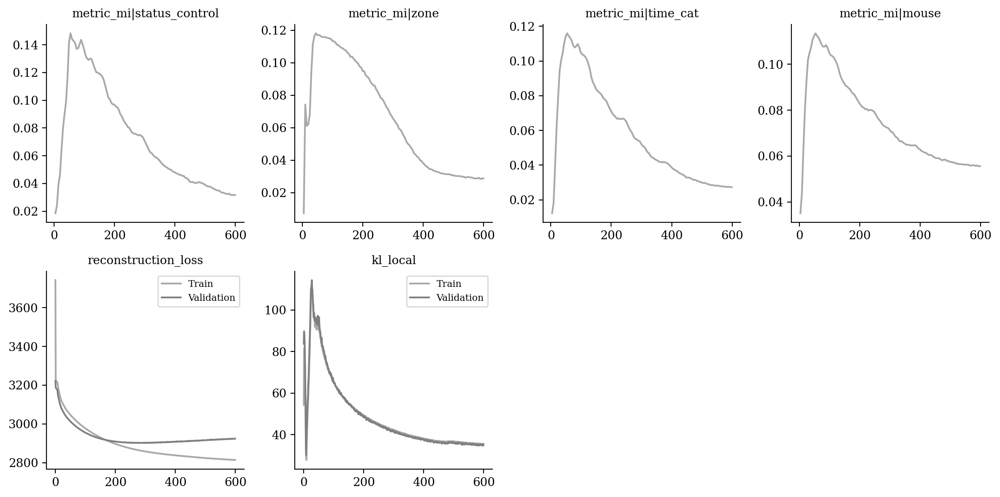

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

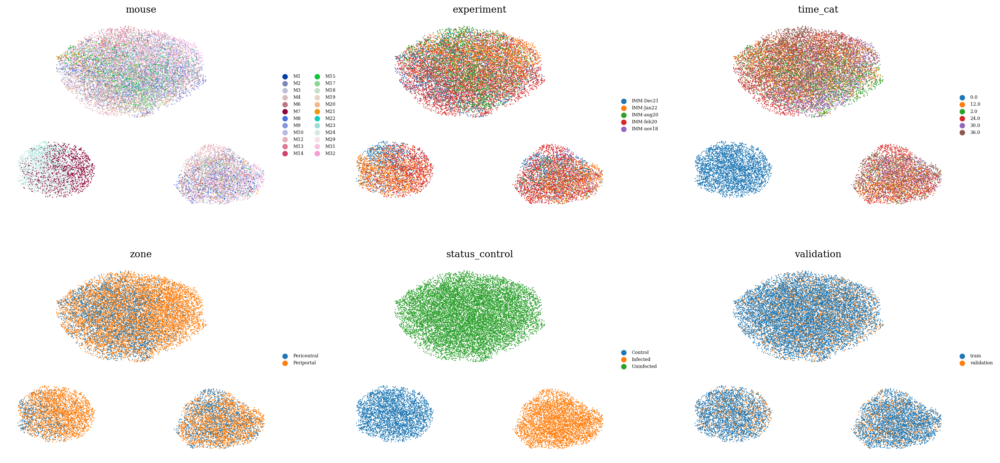

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

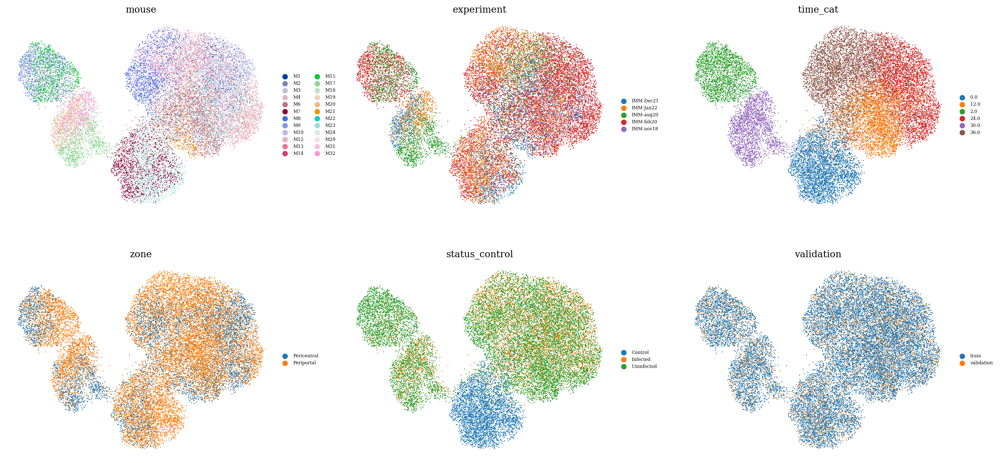

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

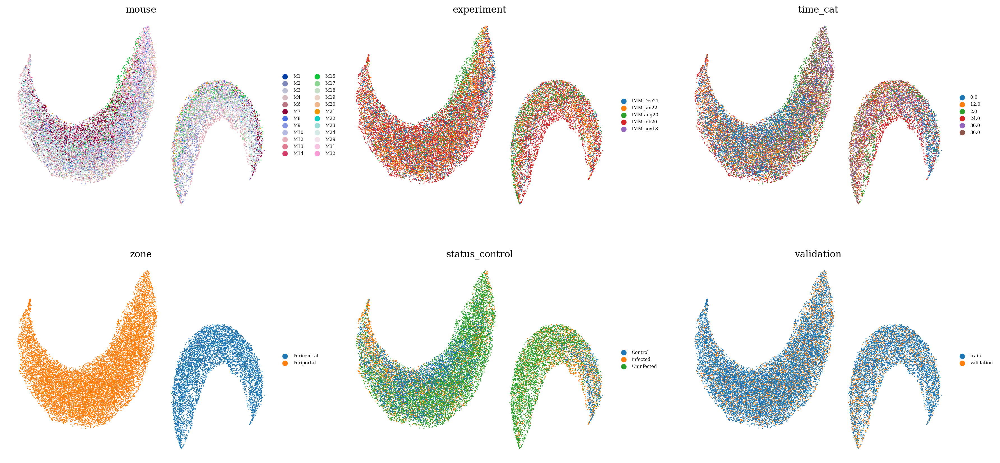

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

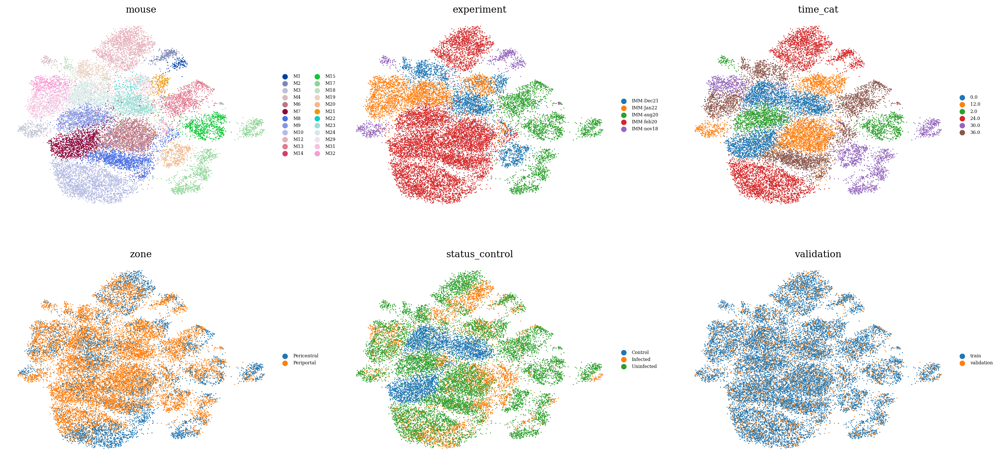

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

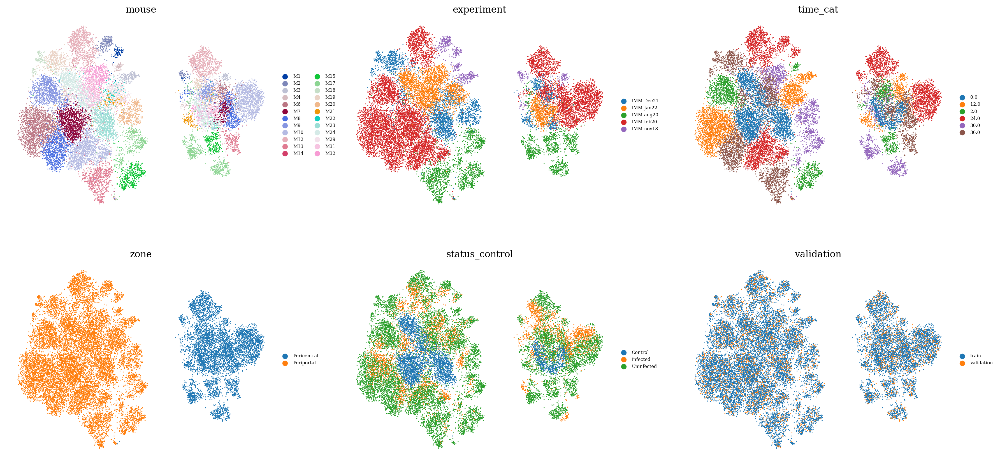

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

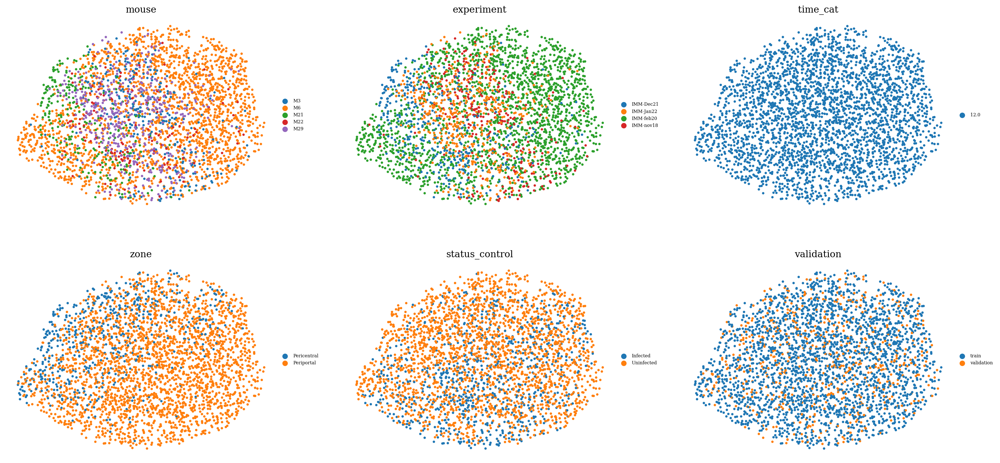

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )